<a href="https://colab.research.google.com/github/hv4626/ImageRestoration_using_Wavelets/blob/main/Image_Restoration_based_on_Wavelets.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Assignment 3 - *Wavelets and Image Restoration*
> by Annie John D'souza (20D070028) and Harshvardhan (20D070035)



In [ ]:
#importing all necessary libraries and packages
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow 
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy import signal
import pywt
import math

#Q1

##a
Add additive white Gaussian noise (AWGN) with variable variance to any given image, whether grayscale or color. The noise should be independent in RGB channels for color images

Saving tg.jpg to tg (4).jpg


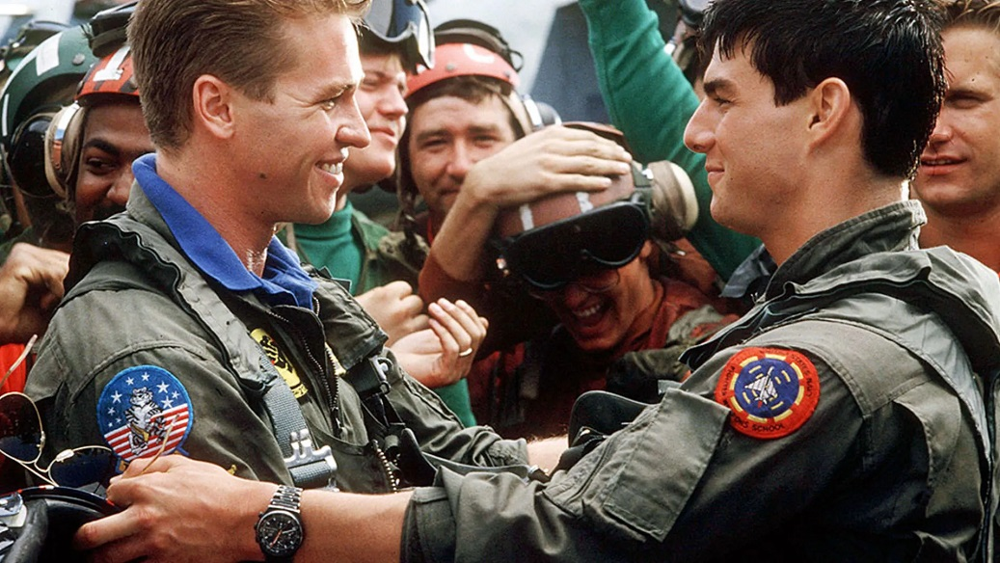

In [ ]:
#uploading and displaying the image
files.upload()
uploaded = cv2.imread("tg.jpg")
img = uploaded.copy()
cv2_imshow(img)

Below we've displayed an image with AWGN without and with clipping

The shape of the image is (584, 1037, 3)
The shape of the AWGN matrix is (584, 1037)


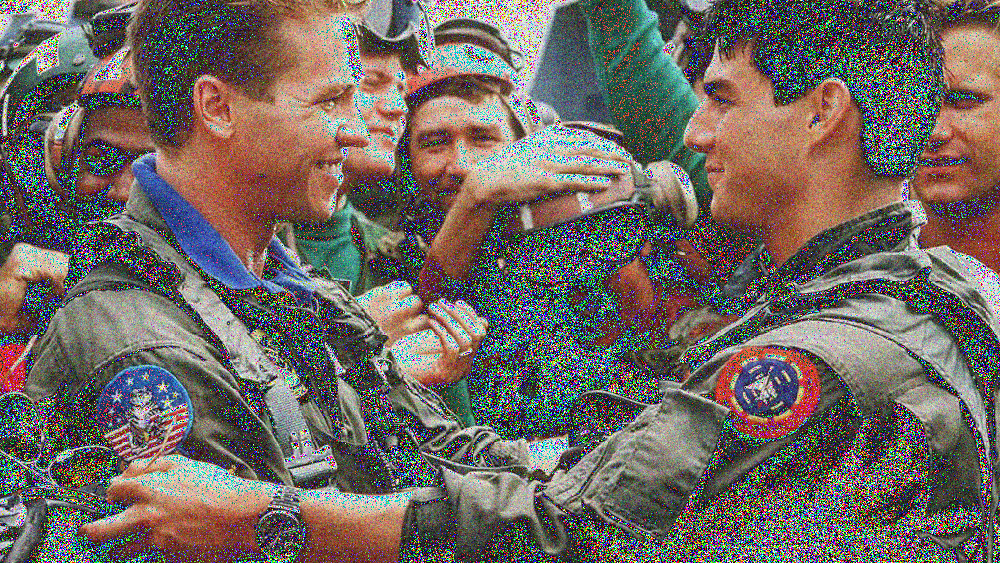

In [ ]:
shape = img.shape
#setting mean and variance as variables
mean = 0
var1 = 600
print(f"The shape of the image is {shape}")
#defining an AWGN variable
AWGN = np.random.normal(mean, np.sqrt(var1), (shape[0], shape[1]))
print(f"The shape of the AWGN matrix is {AWGN.shape}")
img1 = img.copy()
img2 = img.copy()
#Adding AWGN to the three channels separately
for i in range(3):
  AWGN = np.random.normal(mean,  np.sqrt(var1), (shape[0], shape[1]))
  img1[:,:,i] = img1[:,:,i] + AWGN
cv2_imshow(img1)

The shape of the image is (584, 1037, 3)
The shape of the AWGN matrix is (584, 1037)


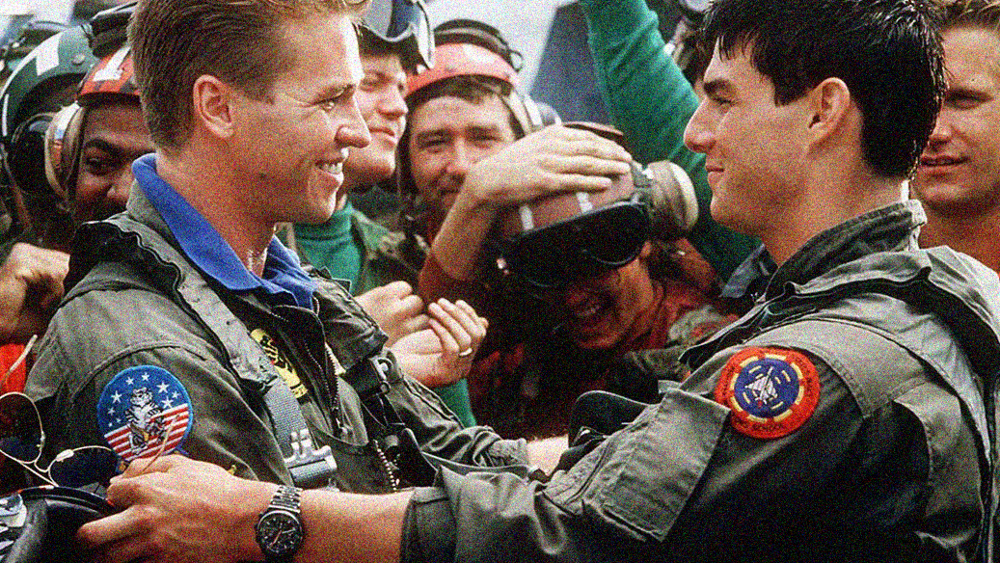

In [ ]:
shape = img.shape
#setting mean and variance as variables
mean = 0
var1 = 600
print(f"The shape of the image is {shape}")
#defining an AWGN variable
AWGN = np.random.normal(mean, np.sqrt(var1), (shape[0], shape[1]))
print(f"The shape of the AWGN matrix is {AWGN.shape}")

img1 = img.copy()
img2 = img.copy()
#Adding AWGN to the three channels separately
for i in range(3):
  AWGN = np.random.normal(mean,  np.sqrt(var1), (shape[0], shape[1]))
  img1[:,:,i] = np.clip(img1[:,:,i] + AWGN,0,255) #clipping the intensity values so they lie between 0 and 255
cv2_imshow(img1)

##b
>  Measure PSNR (with 255 as the default peak, but it should also be variable) between a restored
image and a ground-truth image. Do not import a PSNR function directly, even if available.

In [ ]:
#defining default peak as 255
peak = 255
#defining a psnr function
def psnr_func(orig, img2):
  shp = orig.shape
  diff = np.square(orig - img2)
  rmse = np.sqrt(np.sum(diff)/(shp[0]*shp[1]*shp[2]))#calculating rmse between the restored and original image
  PSNR = 20*np.log(peak/rmse)#calculating psnr as per the definition
  return PSNR

In [ ]:
#Reference: https://pywavelets.readthedocs.io/en/latest/ref/thresholding-functions.html, https://pywavelets.readthedocs.io/en/0.2.0/ref/2d-dwt-and-idwt.html, https://pywavelets.readthedocs.io/en/0.2.0/regression/wp2d.html, https://pywavelets.readthedocs.io/en/0.2.0/ref/thresholding-functions.html#module-pywt.thresholding

def thresholding(img, value, mode): #defined a thresholding function taking values for source image, threshold value and the mode i.e. 'soft' or 'hard'
  data = np.asarray(img) #Storing the wavelet tarnsformed image data irrespective of its type(btw its a tuple :P) to array form to perform operations
  magnitude=np.absolute(img) #As the Wavelet Transform Image Data contains value from -192 to 225 i.e. negetive too, converting to one side of the number scale
  if mode == 'soft': #Soft Thresholding
      threshold=((magnitude-value)/magnitude) #Creating a variable to check its transformed image value with the threshold value, will be used for the more than threshold value to be directly replaced
      threshold.clip(min=0,max=None,out=threshold) # Clip function is used to limit the minimum value to '0' irrespective of the range
      threshold *= img # Now the twist is we not only have to make the less than theshold values to be '0' but subtracting the other value with the threshold itself for which the variable 'threshold' is serving the purpose by multipling it with the wavelet transformed image
      return threshold # returns back the final image which is thresholded 
  elif mode == 'hard': #Hard Thresholding
      zeroed = np.less(np.absolute(img),value) # Made a smart use of numpy to check the coreesponding abolute cell values of transformed image with zero and storing
      return np.where(zeroed,0,img) #Smarting replacing the places where the zeroed variable was stored with 0 :)

def waveletthresholded_soft(img): # Defined a Transformation function for which the earlier made thresholding fuction i.e. Soft will complement
  coeffs = pywt.dwt2(img, 'haar') # The coefficients of the tuple of level 1 wavelet transform i.e. LL, LH, HL, HH are stored as tuple form after performing dwt2 operation for haar wavelet
  cA, (cH, cV, cD) = coeffs # respective coefficents are stored in arrays in tuple form
  thresholding_LH_soft = thresholding(cH,donoho, mode='soft') #Using the function to input LH quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HL_soft = thresholding(cV,donoho, mode='soft') #Using the function to input HL quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HH_soft = thresholding(cD,donoho, mode='soft') #Using the function to input HH quadrant of Wavelet Transform with donoho value calculated above
  return pywt.idwt2((cA,(thresholding_LH_soft,thresholding_HL_soft,thresholding_HH_soft)),'haar') #Returning the inverse transformed image back in the tuple format for the soft threshold

def waveletthresholded_hard(img): # Defined a Transformation function for which the earlier made thresholding fuction i.e. Hard will complement
  coeffs = pywt.dwt2(img, 'haar') #Same
  cA, (cH, cV, cD) = coeffs #Same
  thresholding_LH_hard = thresholding(cH,donoho, mode='hard') #Using the function to input LH quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HL_hard = thresholding(cV,donoho, mode='hard') #Using the function to input HL quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HH_hard = thresholding(cD,donoho, mode='hard') #Using the function to input HH quadrant of Wavelet Transform with donoho value calculated above
  return pywt.idwt2((cA,(thresholding_LH_hard,thresholding_HL_hard,thresholding_HH_hard)),'haar') #Returning the inverse transformed image back in the tuple format for the hard threshold

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


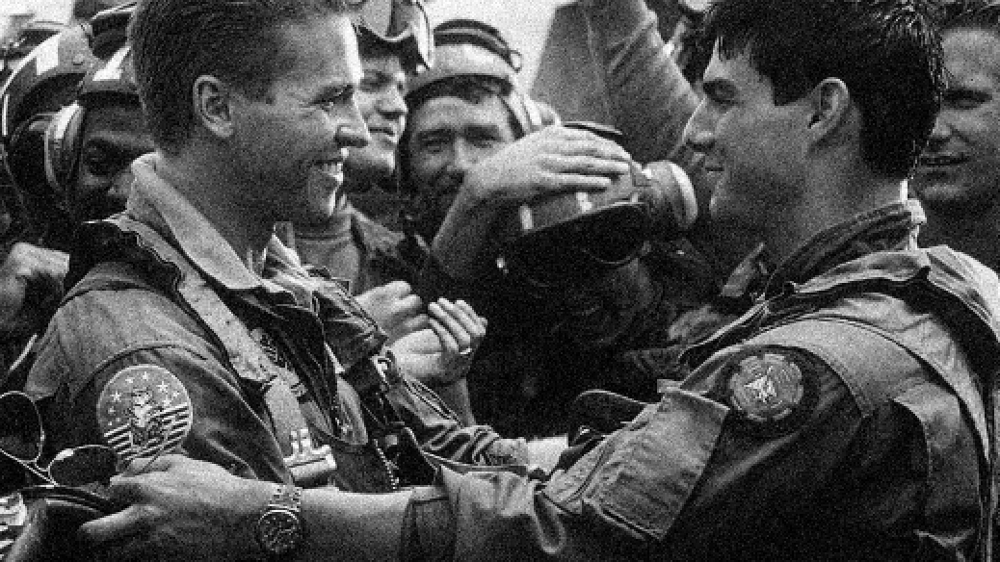

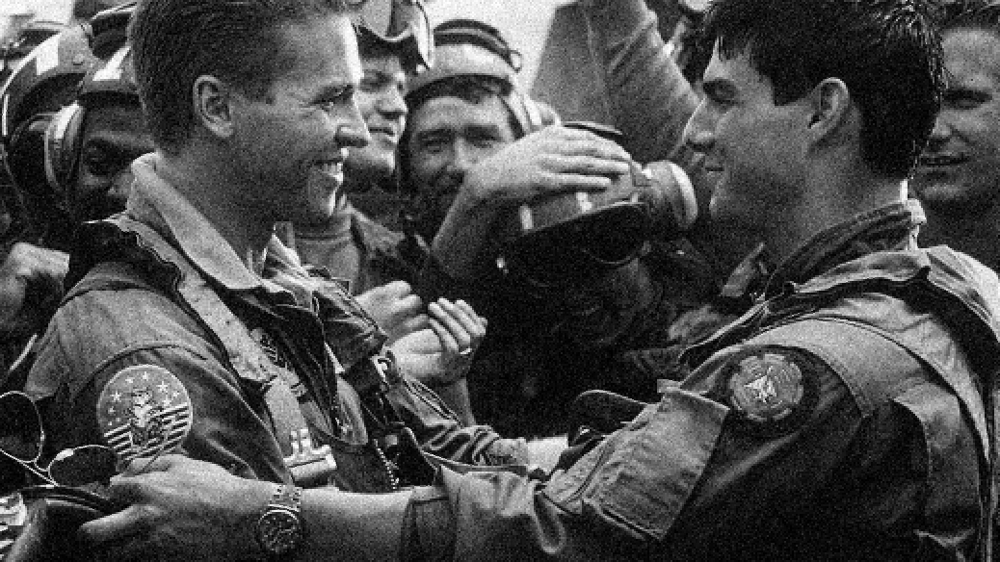

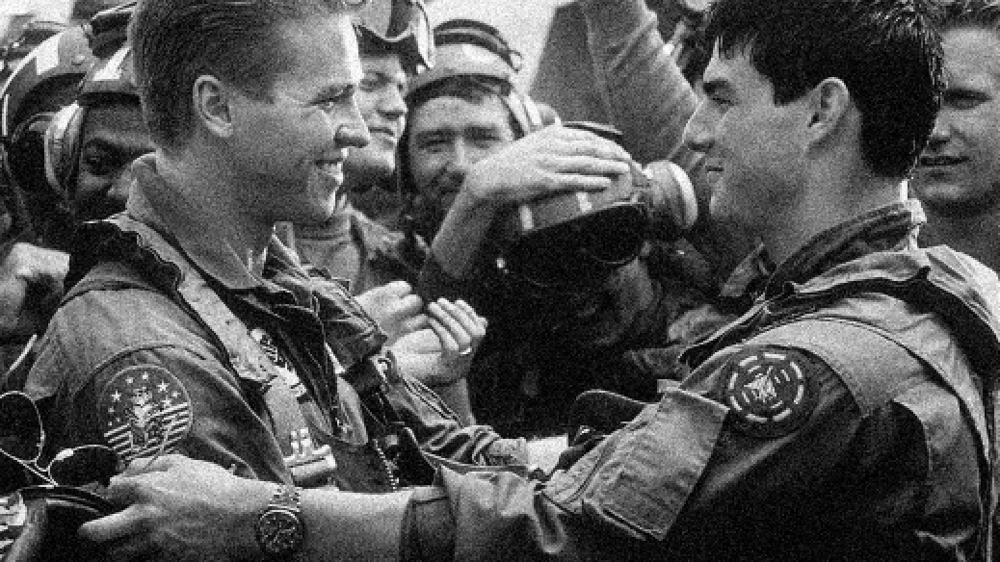

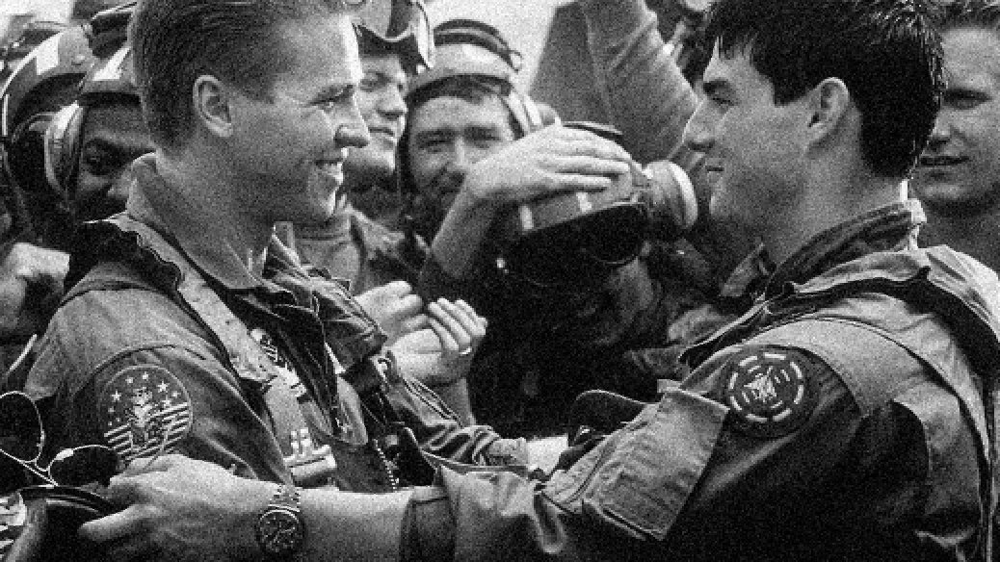

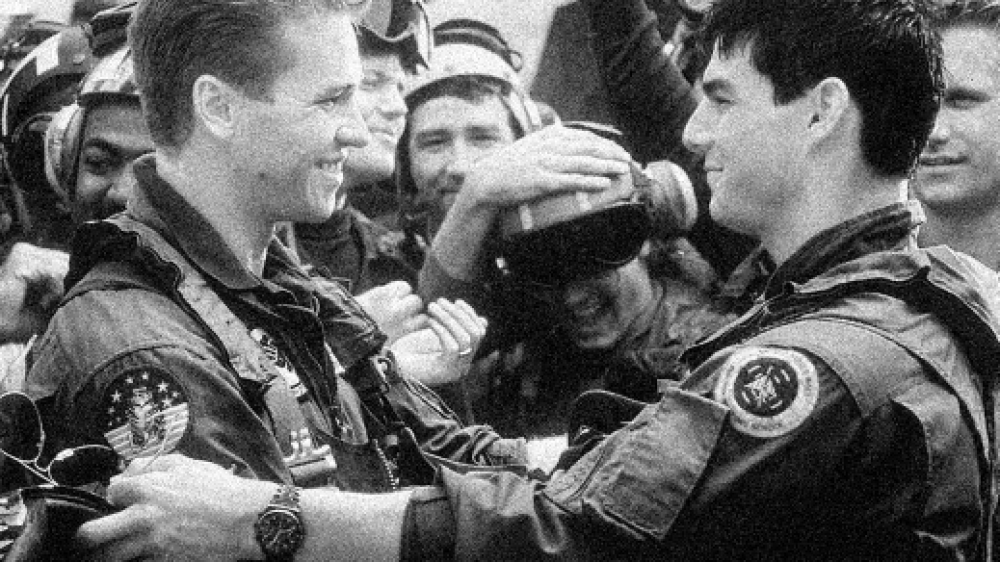

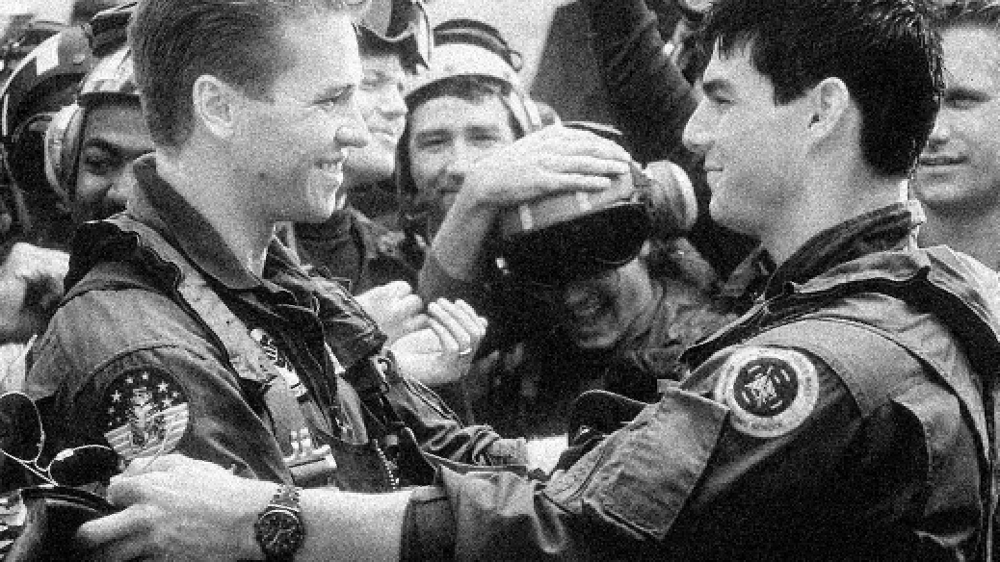

In [ ]:
h,w =  img1.shape[:2] # Stored the Height and Width of the image in variables h and w
window_size = h*w # Created a variable window_size to store h*w
var= var1 #Basically sigma of the donoho expression set to 10 
donoho = np.sqrt(var)*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}

img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
img1_g= img1[:,:,1]
img1_r= img1[:,:,2]
img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
img1_finale_hard = img1.copy()

newimg_soft_b = waveletthresholded_soft(img1_b) # We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
cv2_imshow(newimg_soft_b)
newimg_hard_b = waveletthresholded_hard(img1_b)
cv2_imshow(newimg_hard_b)
print("\n")
newimg_soft_g = waveletthresholded_soft(img1_g)
cv2_imshow(newimg_soft_g)
newimg_hard_g = waveletthresholded_hard(img1_g)
cv2_imshow(newimg_hard_g)
print("\n")
newimg_soft_r = waveletthresholded_soft(img1_r)
cv2_imshow(newimg_soft_r)
newimg_hard_r = waveletthresholded_hard(img1_r)
cv2_imshow(newimg_hard_r)

newimg_soft_b = newimg_soft_b[:,:1037]#cropping the array to obtain proper image size
newimg_soft_g = newimg_soft_g[:,:1037]
newimg_soft_r = newimg_soft_r[:,:1037]
newimg_hard_b = newimg_hard_b[:,:1037]
newimg_hard_g = newimg_hard_g[:,:1037]
newimg_hard_r = newimg_hard_r[:,:1037]

Above is displayed the soft and hard thresholded images of the three channels - b, g and r

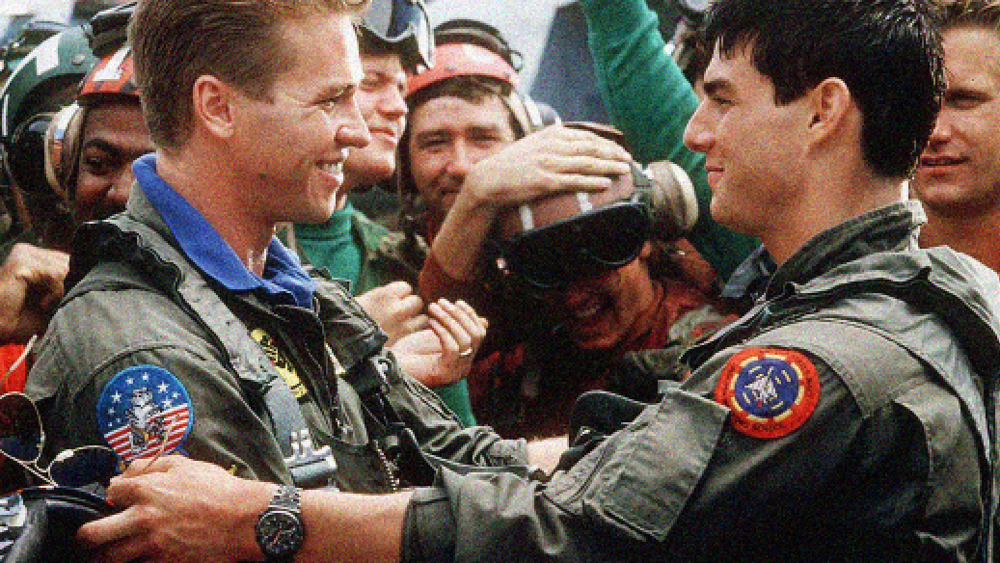

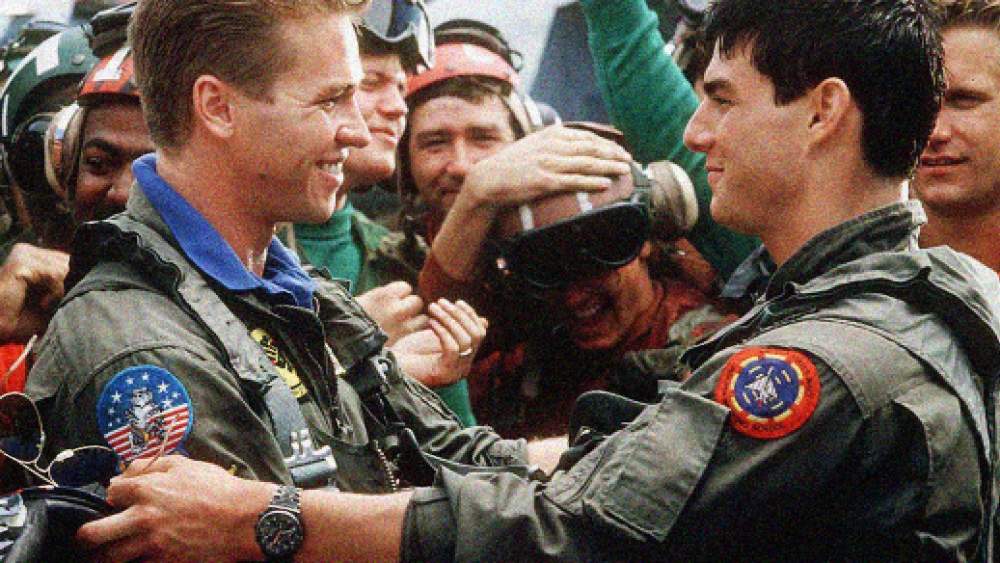

In [ ]:
img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color and diplayed respectively for soft and hard thresholdings
img1_finale_soft[:,:,1] = newimg_soft_g
img1_finale_soft[:,:,2] = newimg_soft_r
cv2_imshow(img1_finale_soft)
print("\n")
img1_finale_hard[:,:,0] = newimg_hard_b
img1_finale_hard[:,:,1] = newimg_hard_g
img1_finale_hard[:,:,2] = newimg_hard_r
cv2_imshow(img1_finale_hard)
print("\n")

In [ ]:
#calculating the psnr between the original and soft/ hard thresholded images
psnr_soft = psnr_func(img , img1_finale_soft)
psnr_hard = psnr_func(img , img1_finale_hard)
print(f"The PSNR between the ground truth image and the image got through soft thresholding restoration is {psnr_soft} \nwhile the PSNR between the ground truth image and the image got through soft thresholding restoration is {psnr_hard}")

The PSNR between the ground truth image and the image got through soft thresholding restoration is 67.83051239774117 
while the PSNR between the ground truth image and the image got through soft thresholding restoration is 67.83503395154419


##c
>  Measure SSIM (with power 1 for all three elements -- mean, variance, correlation -- which can be
varied too) between a restored and a ground-truth image. Do not import an SSIM function directly,
even if available.

In [ ]:
#defining the ssim function 
#going to calculate SSIM for each channel and take the average 
def ssim_func(x , y):
  shp = x.shape
  alpha , beta , gamma = 1 , 1 , 1 #setting the powers as 1
  sumx , sumy, sumxy = 0 , 0 , 0
  ux = np.sum(x)/shp[0]*shp[1]  #calculating means of both images
  uy = np.sum(y)/shp[0]*shp[1]
  sumx = np.sum(np.square(x-ux)) 
  sumy = np.sum(np.square(y-uy))
  sumxy = np.sum((x-ux)*(y-uy))
  stdx = np.sqrt(sumx/(shp[0]*shp[1] - 1)) #calculating the standrd deviation of both images
  stdy = np.sqrt(sumy/(shp[0]*shp[1] - 1))
  varxy = sumxy/(shp[0]*shp[1] - 1) #calculating the covariance of both images
  l = 2*ux*uy/(ux**2 + uy**2) #calculating the luminance comparison function
  c = 2*stdx*stdy/(stdx**2 + stdy**2) #calculating the contrast comparison function
  s = varxy/(stdx*stdy) #calculating the structure comparison function
  SSIM = np.power(l , alpha)*np.power(c, beta)*np.power(s, gamma) #calculating SSIM according to definition
  return SSIM


#calculating ssim of the 3 channels between the soft thresholded image and original image
ssims_blue , ssims_green , ssims_red = ssim_func(img[:,:,0] , img1_finale_soft[:,:,0]) , ssim_func(img[:,:,1] , img1_finale_soft[:,:,1]) , ssim_func(img[:,:,2] , img1_finale_soft[:,:,2])
print(f"Thus, using soft thresholding, the SSIM's for the three channels are: blue SSIM = {ssims_blue} , green SSIM = {ssims_green} , red SSIM = {ssims_red}")

#calculating ssim of the 3 channels between the hard thresholded image and original image
ssimh_blue , ssimh_green , ssimh_red = ssim_func(img[:,:,0] , img1_finale_hard[:,:,0]) , ssim_func(img[:,:,1] , img1_finale_hard[:,:,1]) , ssim_func(img[:,:,2] , img1_finale_hard[:,:,2])
print(f"Thus, using soft thresholding, the SSIM's for the three channels are: blue SSIM = {ssimh_blue} , green SSIM = {ssimh_green} , red SSIM = {ssimh_red}")

#calculating the average sim between the soft thresholded image and original image
ssims_avg = (ssims_blue+ssims_green+ssims_red)/3
print(f"The SSIM of the image is {ssims_avg}")

#calculating the average sim between the hard thresholded image and original image
ssimh_avg = (ssimh_blue+ssimh_green+ssimh_red)/3
print(f"The SSIM of the image is {ssimh_avg}")

Thus, using soft thresholding, the SSIM's for the three channels are: blue SSIM = 0.9999187479969092 , green SSIM = 0.9999661829203287 , red SSIM = 0.9999998312461071
Thus, using soft thresholding, the SSIM's for the three channels are: blue SSIM = 0.9999186244882078 , green SSIM = 0.9999661142352165 , red SSIM = 0.9999998276303701
The SSIM of the image is 0.9999615873877815
The SSIM of the image is 0.9999615221179315


##d
> Isotropic Gaussian blurring (Gaussian low pass filtering) of an image for a given variance.

Saving top_gun2.jpg to top_gun2.jpg


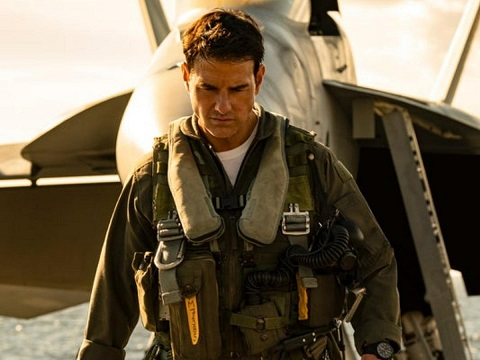

In [ ]:
#uloading and displaying an image
files.upload()
tg = cv2.imread("top_gun2.jpg")
cv2_imshow(tg)

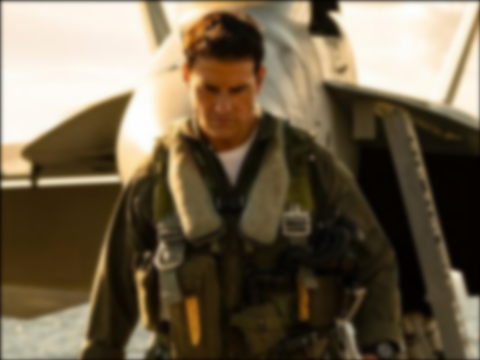

In [ ]:
tg1 = tg.copy()
#setting the variable variiance as 5
var = 5
#creating an array of equally spaced numbers from -10 to 10
t = np.linspace(-10, 10, 30)
#creating a gaussian array using the previous
bump = np.exp(-t**2/var)
 # normalizing the integral to 1
bump /= np.trapz(bump) 
# making a 2-D kernel out of it
kernel = bump[:, np.newaxis] * bump[np.newaxis, :]
#convolving the original image with the 2D kernel and displaying
mod = signal.fftconvolve(tg1, kernel[:, :, np.newaxis], mode='same')
cv2_imshow(mod)

#Q2

##a,b
a. Hard thresholding: set to zero any detail (LH, HL, HH) coefficient that is below a threshold (threshold
should be variable).

b. Soft threhsolding: set to zero any detail (LH, HL, HH) coefficient that is below a threshold (threshold
should be variable), and subtract the threshold from those that are above the threshold.



Saving tom1.jpg to tom1.jpg


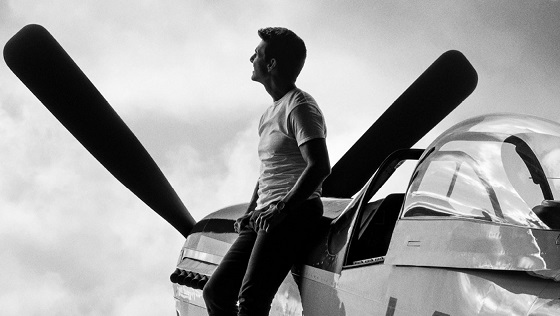

(316, 560)


In [ ]:
files.upload()
uploaded = cv2.imread("tom1.jpg",0)
img = uploaded.copy()
cv2_imshow(img)
print(img.shape)
#Uploaded a Tom Cruise poster in greyscale to test thresholding and printed its shape

In [ ]:
h,w =  img.shape[:2] # Stored the Height and Width of the image in variables h and w
window_size = h*w # Created a variable window_size to store h*w
var= 10 #Basically sigma of the donoho expression set to 10 
donoho = var*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}

In [ ]:
#Reference: https://pywavelets.readthedocs.io/en/latest/ref/thresholding-functions.html, https://pywavelets.readthedocs.io/en/0.2.0/ref/2d-dwt-and-idwt.html, https://pywavelets.readthedocs.io/en/0.2.0/regression/wp2d.html, https://pywavelets.readthedocs.io/en/0.2.0/ref/thresholding-functions.html#module-pywt.thresholding

def thresholding(img, value, mode): #defined a thresholding function taking values for source image, threshold value and the mode i.e. 'soft' or 'hard'
  data = np.asarray(img) #Storing the wavelet tarnsformed image data irrespective of its type(btw its a tuple :P) to array form to perform operations
  magnitude=np.absolute(img) #As the Wavelet Transform Image Data contains value from -192 to 225 i.e. negetive too, converting to one side of the number scale
  if mode == 'soft': #Soft Thresholding
      threshold=((magnitude-value)/magnitude) #Creating a variable to check its transformed image value with the threshold value, will be used for the more than threshold value to be directly replaced
      threshold.clip(min=0,max=None,out=threshold) # Clip function is used to limit the minimum value to '0' irrespective of the range
      threshold *= img # Now the twist is we not only have to make the less than theshold values to be '0' but subtracting the other value with the threshold itself for which the variable 'threshold' is serving the purpose by multipling it with the wavelet transformed image
      return threshold # returns back the final image which is thresholded 
  elif mode == 'hard': #Hard Thresholding
      zeroed = np.less(np.absolute(img),value) # Made a smart use of numpy to check the coreesponding abolute cell values of transformed image with zero and storing
      return np.where(zeroed,0,img) #Smarting replacing the places where the zeroed variable was stored with 0 :)

In [ ]:
def waveletthresholded_soft(img): # Defined a Transformation function for which the earlier made thresholding fuction i.e. Soft will complement
  coeffs = pywt.dwt2(img, 'haar') # The coefficients of the tuple of level 1 wavelet transform i.e. LL, LH, HL, HH are stored as tuple form after performing dwt2 operation for haar wavelet
  cA, (cH, cV, cD) = coeffs # respective coefficents are stored in arrays in tuple form
  thresholding_LH_soft = thresholding(cH,donoho, mode='soft') #Using the function to input LH quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HL_soft = thresholding(cV,donoho, mode='soft') #Using the function to input HL quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HH_soft = thresholding(cD,donoho, mode='soft') #Using the function to input HH quadrant of Wavelet Transform with donoho value calculated above
  return pywt.idwt2((cA,(thresholding_LH_soft,thresholding_HL_soft,thresholding_HH_soft)),'haar') #Returning the inverse transformed image back in the tuple format for the soft threshold

def waveletthresholded_hard(img): # Defined a Transformation function for which the earlier made thresholding fuction i.e. Hard will complement
  coeffs = pywt.dwt2(img, 'haar') #Same
  cA, (cH, cV, cD) = coeffs #Same
  thresholding_LH_hard = thresholding(cH,donoho, mode='hard') #Using the function to input LH quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HL_hard = thresholding(cV,donoho, mode='hard') #Using the function to input HL quadrant of Wavelet Transform with donoho value calculated above
  thresholding_HH_hard = thresholding(cD,donoho, mode='hard') #Using the function to input HH quadrant of Wavelet Transform with donoho value calculated above
  return pywt.idwt2((cA,(thresholding_LH_hard,thresholding_HL_hard,thresholding_HH_hard)),'haar') #Returning the inverse transformed image back in the tuple format for the hard threshold

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


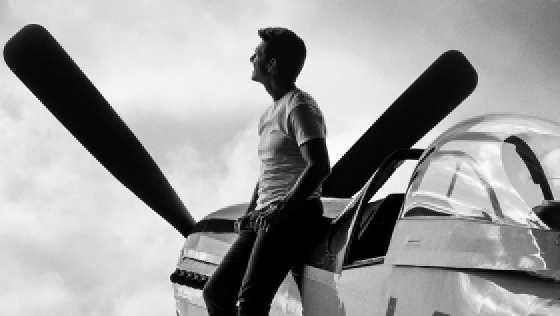

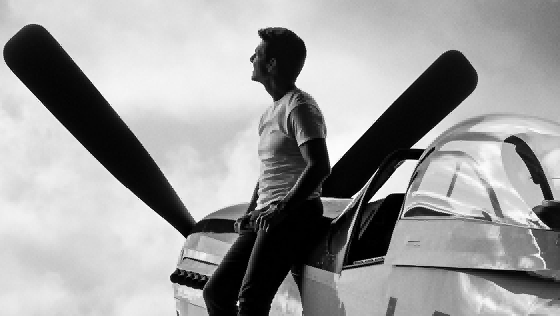

In [ ]:
newimg_soft = waveletthresholded_soft(img) #Passing the image to the cascaded set of functions defined above for soft thresholding and storing it display
cv2_imshow(newimg_soft)
newimg_hard = waveletthresholded_hard(img) #Passing the image to the cascaded set of functions defined above for hard thresholding and storing it display
cv2_imshow(newimg_hard)

Saving tom1.jpg to tom1 (1).jpg


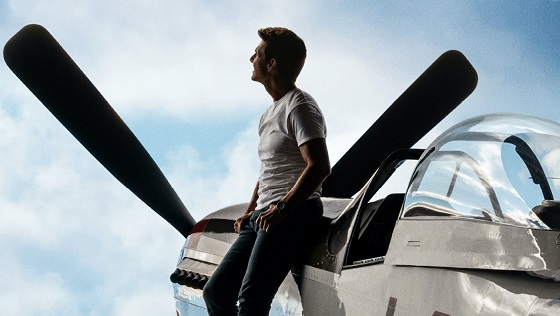

In [ ]:
files.upload()
uploaded = cv2.imread("tom1.jpg",-1) #-1 helps to automaticattly decide based on the current configuratuion irrespective of previous versions like here it restore its color back from grayscale
img1 = uploaded.copy()
cv2_imshow(img1) #Display

In [ ]:
img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
img1_g= img1[:,:,1]
img1_r= img1[:,:,2]
img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
img1_finale_hard = img1.copy()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


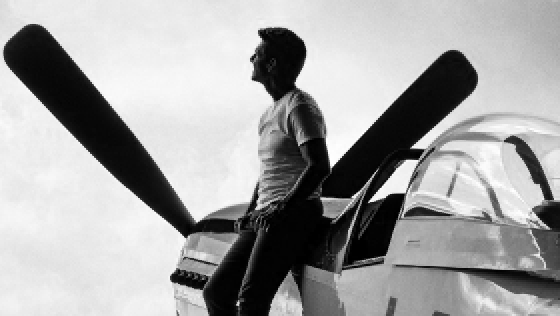

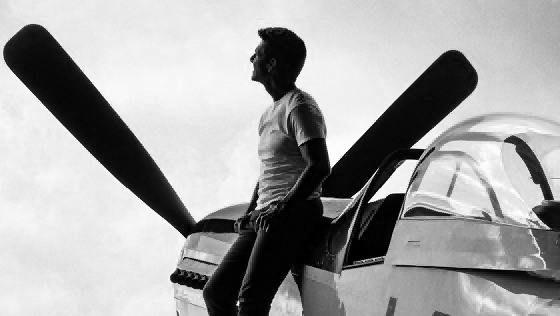

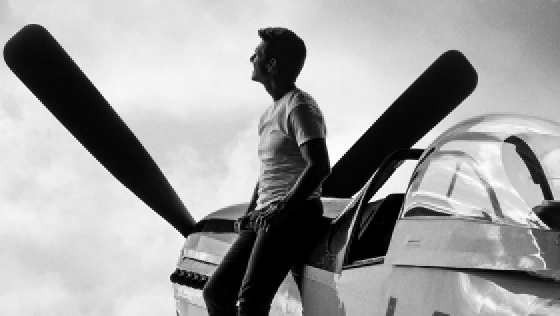

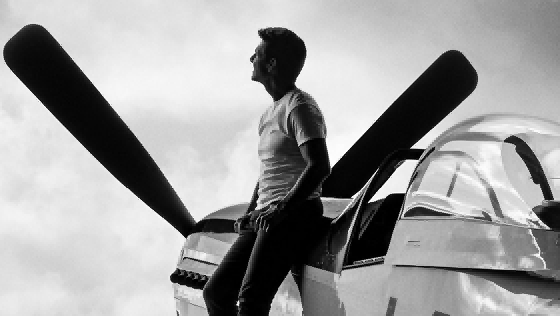

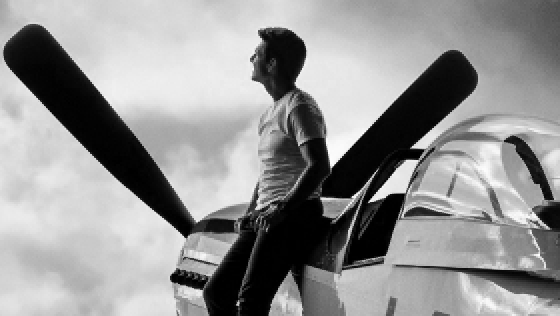

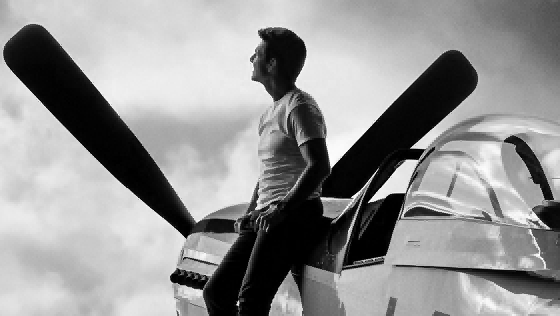

In [ ]:
newimg_soft_b = waveletthresholded_soft(img1_b) # Summary of this cell: We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
cv2_imshow(newimg_soft_b)
newimg_hard_b = waveletthresholded_hard(img1_b)
cv2_imshow(newimg_hard_b)
print("\n")
newimg_soft_g = waveletthresholded_soft(img1_g)
cv2_imshow(newimg_soft_g)
newimg_hard_g = waveletthresholded_hard(img1_g)
cv2_imshow(newimg_hard_g)
print("\n")
newimg_soft_r = waveletthresholded_soft(img1_r)
cv2_imshow(newimg_soft_r)
newimg_hard_r = waveletthresholded_hard(img1_r)
cv2_imshow(newimg_hard_r)

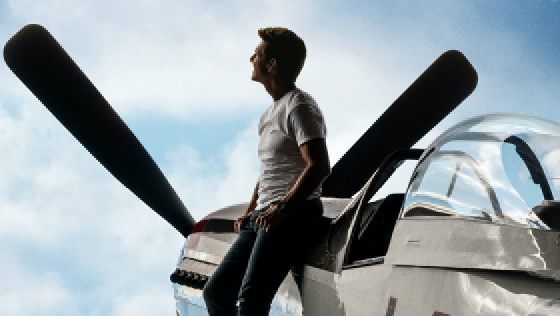

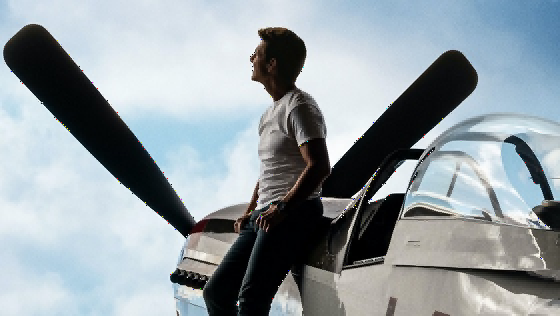

In [ ]:
img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color nad diplayed respectively for soft and hard thresholdings
img1_finale_soft[:,:,1] = newimg_soft_g
img1_finale_soft[:,:,2] = newimg_soft_r
cv2_imshow(img1_finale_soft)
img1_finale_hard[:,:,0] = newimg_hard_b
img1_finale_hard[:,:,1] = newimg_hard_g
img1_finale_hard[:,:,2] = newimg_hard_r
cv2_imshow(img1_finale_hard)
print("\n")

##c
The method proposed in the paper “Image Denoising using Neighbouring Wavelet Coefficients” by
Chen et al.

In [ ]:
window_size = int(input('Window Size '))**2 #square windows, optimum is at 3 # Taking the Size of sub-block from the user where dimension of 3 or 5 is optimum for good results
var= 10 # Taking sigma as randomly as 10
chen = np.sqrt(4*math.log(window_size)*var**2) # Using the Chens formula for threshoding 
print(chen)

Window Size 3
29.64607614735022


In [ ]:
coeffs = pywt.dwt2(img, 'haar') # The coefficients of the tuple of level 1 wavelet transform i.e. LL, LH, HL, HH are stored as tuple form after performing dwt2 operation for haar wavelet
cA, (cH, cV, cD) = coeffs # respective coefficents are stored in arrays in tuple form

In [ ]:
print(cV.shape) #Printing the shape of each cH,cV, and cD to cross check shape
print(cD.shape)
print(cH.shape)

(158, 280)
(158, 280)
(158, 280)


In [ ]:
pad = int((np.sqrt(window_size)-1)/2)
cH_pad = cv2.copyMakeBorder(cH,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cH, to check for boundary condition, we are zero-padding the wavelet transforms 
print(cH_pad.shape) #Checking for the shape of the zero-padded cH array
cV_pad = cv2.copyMakeBorder(cV,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cV, to check for boundary condition, we are zero-padding the wavelet transforms 
print(cV_pad.shape) #Checking for the shape of the zero-padded cH array
cD_pad = cv2.copyMakeBorder(cD,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cD, to check for boundary condition, we are zero-padding the wavelet transforms 
print(cD_pad.shape) #Checking for the shape of the zero-padded cH array

(160, 282)
(160, 282)
(160, 282)


In [ ]:
def chen_thresholding(img, chen, window_size): #defined a thresholding function taking values for source image, threshold value i.e. chen here and window size which we asked and calculated earlier
  chen1 = chen**2 #To fit it into the formula, squared the calculated chen variable
  if window_size == 9: #Out of optimized window size i.e. 3 and 5, hard coded it for window size 3 and 5 respectively
    for i in range(1,cH_pad.shape[0]-3): #Made a for loop to go through all the individual cells where we dynamically want to get data and calulate the function
     for j in range(1,cH_pad.shape[1]-3):
       sum = img[i-1,j]**2+img[i+1,j]**2+img[i-1,j-1]**2+img[i,j-1]**2+img[i+1,j+1]**2+img[i-1,j+1]**2+img[i,j]**2+img[i+1,j+1]**2 + img[i,j+1]**2 # For window size 3, we have to take conisderation of the surrounding one layer of pixel padding the selected one and square added
       beta = (1 - chen1/sum) #Calculated the beta functionn as per the paper
       if beta < 0: #Checking the condition where if the calculated beta is negetive then it makes the coressponding pixel 0
        beta = 0 
       img[i][j] *= beta #Else thresholding that pixel with beta 
    return img #Returning the array
  if window_size == 25:
    for i in range(2,cH_pad.shape[0]-5):
     for j in range(2,cH_pad.shape[1]-5):
       sum = img[i-1,j]**2+img[i+1,j]**2+img[i-1,j-1]**2+img[i,j-1]**2+img[i+1,j+1]**2+img[i-1,j+1]**2+img[i,j]**2+img[i+1,j+1]**2+img[i-2,j-2]**2+img[i-2,j-1]**2+img[i-2,j]**2+img[i-2,j+1]**2+img[i-2,j+2]**2+img[i-1,j-2]**2+img[i+1,j+2]**2+img[i,j-2]**2+img[i,j+2]**2+img[i+1,j-2]**2+img[i+1,j+2]**2+img[i+2,j-2]**2+img[i+2,j-1]**2+img[i+2,j]**2+img[i+2,j+1]**2+img[i+2,j+2]**2 # For window size 5, we have to take conisderation of the surrounding two layer of pixel padding the selected one and square added
       beta = (1 - chen1/sum) #Calculated the beta functionn as per the paper
       if beta < 0:
        beta = 0
       img[i][j] *= beta
    return img

def waveletthresholded_chen(img): # Defined a Transformation function for which the earlier made thresholding fuction i.e. Chen_thresholding will complement
  coeffs = pywt.dwt2(img, 'haar') # The coefficients of the tuple of level 1 wavelet transform i.e. LL, LH, HL, HH are stored as tuple form after performing dwt2 operation for haar wavelet
  cA, (cH, cV, cD) = coeffs # respective coefficents are stored in arrays in tuple form
  chen_thresholding_LH = chen_thresholding(cH,chen,window_size) #Using the function to input LH quadrant of Wavelet Transform with chen value calculated above
  chen_thresholding_HL = chen_thresholding(cV,chen,window_size) #Using the function to input HL quadrant of Wavelet Transform with chen value calculated above
  chen_thresholding_HH = chen_thresholding(cD,chen,window_size) #Using the function to input HH quadrant of Wavelet Transform with chen value calculated above
  # h0,w0 = cA.shape[:2]
  # print(w0)
  # print(chen_thresholding_LH.shape)
  # h1,w1 = chen_thresholding_LH.shape[:2]
  # print(w1)
  return pywt.idwt2((cA,(chen_thresholding_LH,chen_thresholding_HL,chen_thresholding_HH)),'haar') #Returning the inverse transformed image back in the tuple format

In [ ]:
img2 = img1.copy()
img2_b= img2[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
img2_g= img2[:,:,1]
img2_r= img2[:,:,2]
img2_finale_chen = img2.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in double_scalars
  import sys


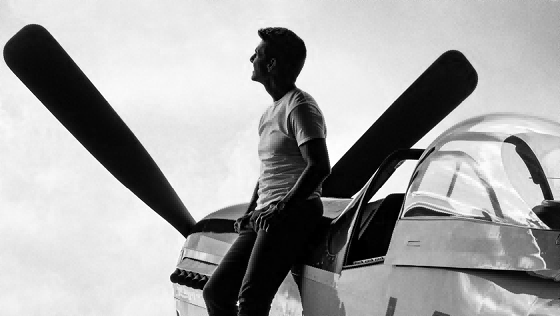

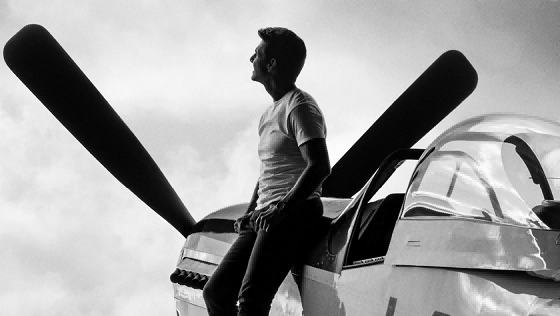

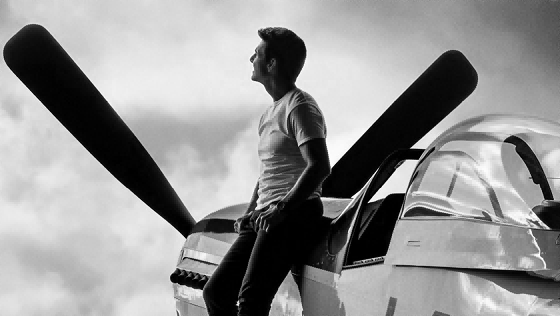

In [ ]:
newimg_chen_b = waveletthresholded_chen(img2_b)
cv2_imshow(newimg_chen_b)
newimg_chen_g = waveletthresholded_chen(img2_g)
cv2_imshow(newimg_chen_g)
newimg_chen_r = waveletthresholded_chen(img2_r)
cv2_imshow(newimg_chen_r)


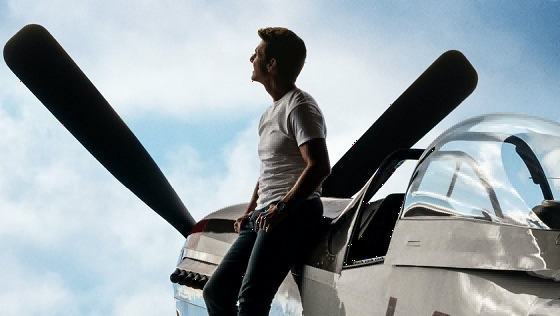

In [ ]:
  img2_finale_chen[:,:,0] = newimg_chen_b
  img2_finale_chen[:,:,1] = newimg_chen_g
  img2_finale_chen[:,:,2] = newimg_chen_r
  cv2_imshow(img2_finale_chen)

#Q3

In [ ]:
#using the psnr and ssim functions defined previously
def psnr_func(orig, img2):
  shp = orig.shape
  diff = np.square(orig - img2)
  rmse = np.sqrt(np.sum(diff)/(shp[0]*shp[1]*shp[2]))
  PSNR = 20*np.log(peak/rmse)
  return PSNR

def ssim_func(x , y):
  shp = x.shape
  alpha , beta , gamma = 1 , 1 , 1
  sumx , sumy, sumxy = 0 , 0 , 0
  ux = np.sum(x)/shp[0]*shp[1]
  uy = np.sum(y)/shp[0]*shp[1]
  sumx = np.sum(np.square(x-ux))
  sumy = np.sum(np.square(y-uy))
  sumxy = np.sum((x-ux)*(y-uy))
  stdx = np.sqrt(sumx/(shp[0]*shp[1] - 1))
  stdy = np.sqrt(sumy/(shp[0]*shp[1] - 1))
  varxy = sumxy/(shp[0]*shp[1] - 1)
  l = 2*ux*uy/(ux**2 + uy**2)
  c = 2*stdx*stdy/(stdx**2 + stdy**2)
  s = varxy/(stdx*stdy)
  SSIM = np.power(l , alpha)*np.power(c, beta)*np.power(s, gamma)
  return SSIM

##a
Noise variance 

Saving rooster.jpg to rooster.jpg


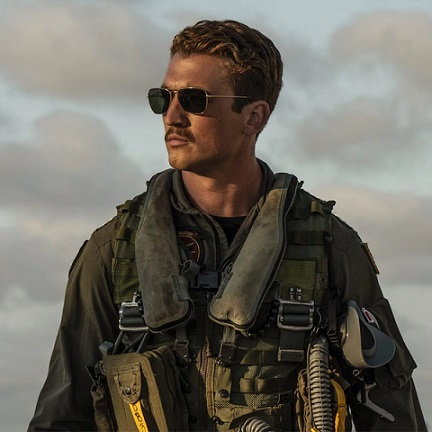

In [ ]:
#uploading and displaying an image
files.upload()
rooster = cv2.imread("rooster.jpg")
cv2_imshow(rooster)

In [ ]:
img = rooster.copy()
mean = 0
#creating empty lists
PSNR = []
SSIM = []
shape = rooster.shape
peak = 255
#looping over the variance
for var in range(1, 101):
  img = rooster.copy()
  #Adding AWGN of the loop variance independently to the three channels of the image as done in Q1
  for i in range(3):
    AWGN = np.random.normal(mean, var, (shape[0], shape[1]))
    img[:,:,i] = img[:,:,i] + AWGN
    img[:,:,i] = (img[:,:,i]/np.max(img[:,:,i]))*255
  #calculating psnr and ssim between the original image and the noisy image
  PSNR.append(psnr_func(rooster , img))
  SSIM.append(np.mean(ssim_func(rooster , img)))

#printing the values obtained
print(PSNR)
print(SSIM)

[108.01592482260881, 96.21446770682597, 88.52708337727807, 82.95931027752373, 78.77061251998532, 75.68590575011359, 73.49353538555026, 71.89241860102476, 70.69197202352092, 69.76128825877663, 69.0607752051109, 68.46435095551638, 67.99011138220844, 67.58828922903669, 67.24549410622328, 66.9508635287524, 66.70016631450582, 66.46973482585823, 66.26038160419664, 66.10236890835237, 65.92487953086555, 65.78463877843912, 65.64178203985803, 65.53407364798959, 65.43353525777228, 65.31370738829057, 65.21556703546148, 65.14084420355096, 65.05885851714831, 65.00641242688498, 64.94868105664189, 64.8898676981093, 64.81667127367946, 64.77985531228536, 64.73886388901458, 64.68924089305789, 64.64753459869218, 64.59544420576819, 64.57542684814251, 64.54472680323677, 64.52580600152135, 64.48555201683864, 64.47068555132343, 64.44433355962497, 64.42880704861321, 64.41564788121084, 64.39547588088645, 64.3648348794819, 64.36036337271457, 64.36294506608905, 64.35312920116613, 64.32682241424124, 64.30917674220

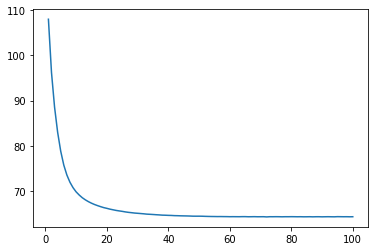

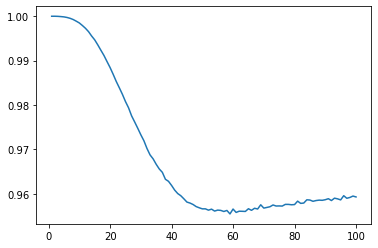

In [ ]:
#plotting the psnr and ssim versus variance
x_axis = np.linspace(1,100,100)
plt.plot(x_axis, PSNR)
plt.show()
plt.plot(x_axis, SSIM)
plt.show()

Thus, we see that as variance increases, PSNR decreases and almost becomes a constant. The SSIM also decreases and stabilizes at a slightly higher value

##b
Gaussian low pass filtering with various variances

Saving top_gun3.jpg to top_gun3.jpg


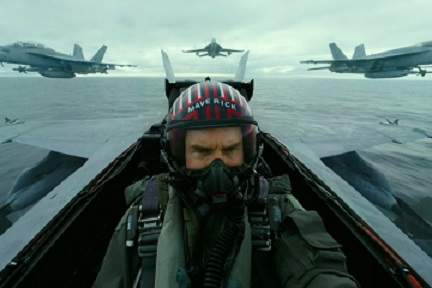

In [ ]:
#uploading and displaying an image
files.upload()
mav = cv2.imread("top_gun3.jpg")
cv2_imshow(mav)

In [ ]:
#using the definition of the gaussian low pass filter as was done in Q1
def glp_filter(img , var):
  t = np.linspace(-10, 10, 30)
  bump = np.exp(-t**2/var)
  bump /= np.trapz(bump) 
  kernel = bump[:, np.newaxis] * bump[np.newaxis, :]
  mod = signal.fftconvolve(img, kernel[:, :, np.newaxis], mode='same')
  return mod

#defining empy lists
PSNR = []
SSIM = []

#looping over variance
for var in range(1, 101):
  img = mav.copy()
  #applying the filter on the image
  blur_img = glp_filter(img,var)
  #appending the psnr and ssim values to the lists
  PSNR.append(psnr_func(mav , blur_img))
  SSIM.append(np.mean(ssim_func(mav , blur_img)))

print(PSNR)
print(SSIM)

[62.83809510685512, 60.22612949210227, 58.40644463473861, 57.07071226330859, 56.03297614948719, 55.1915028603647, 54.48688500092348, 53.88212911091266, 53.35296142514455, 52.88277708234347, 52.45983168344725, 52.07558762354513, 51.72369132489818, 51.39931427493134, 51.09871432348034, 50.81893611333886, 50.55760254615969, 50.312767486173826, 50.08281052404298, 49.86636106858896, 49.662243109760624, 49.469434664927334, 49.287037717083244, 49.11425568783314, 48.95037634811307, 48.79475867444658, 48.64682258626943, 48.50604080328961, 48.37193227745815, 48.244056807456076, 48.122010552697205, 48.00542224151232, 47.893949923522754, 47.78727815570684, 47.68511553991619, 47.58719254987854, 47.49325960034813, 47.40308532167661, 47.316455010837444, 47.23316923566702, 47.15304257336656, 47.07590246754964, 47.00158819061164, 46.9299499001443, 46.86084777966577, 46.794151255188574, 46.72973828017704, 46.667494682306405, 46.607313566164514, 46.54909476666287, 46.492744348466964, 46.43817414723004, 4

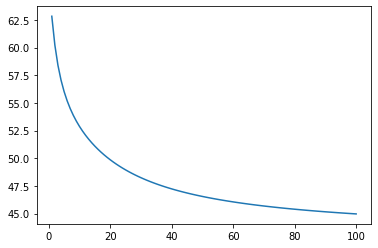

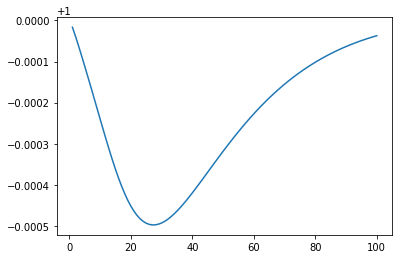

In [ ]:
x_axis = np.linspace(1,100,100)
plt.plot(x_axis, PSNR)
plt.show()
plt.plot(x_axis, SSIM)
plt.show()

Thus, the psnr decreases with increasing variance of the filter. The SSIM initially decreases and later increases.

##c
The two thresholding methods, where threshold is given by λ =𝜎 2 log 𝑛2(as suggested byDonoho et al.), where 𝜎 is noise variance, and 𝑛 is window size. 

Saving mav_flight1.jpg to mav_flight1.jpg


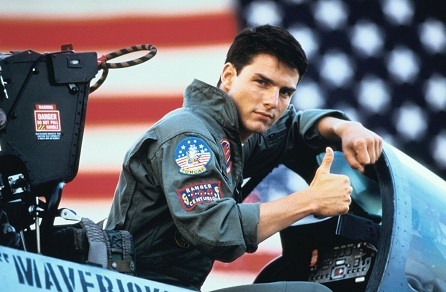

In [ ]:
files.upload()
mav = cv2.imread("mav_flight1.jpg")
mav_gray = cv2.imread("mav_flight1.jpg",0) 
cv2_imshow(mav)

This question was done in 2 ways:

1.   An image with a given noise variance was taken and thresholding with various variances was performed on it 
2.   The thresholding variance was kept the same as the noise variance for different values of variance







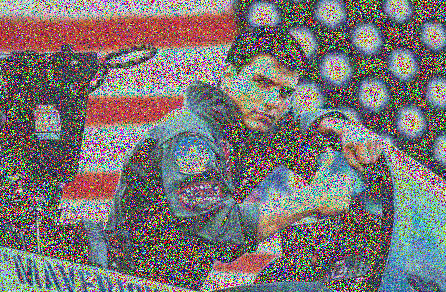

In [ ]:
shape = mav.shape
mean = 0
var1 = 40

#adding AWGN with std dev 40 to the image
img1 = mav.copy()
for i in range(3):
  AWGN = np.random.normal(mean,  var1, (shape[0], shape[1]))
  img1[:,:,i] = img1[:,:,i] + AWGN
cv2_imshow(img1)
mav_gray = mav_gray + AWGN

In [ ]:
#Using different variances while thresholding for an image with noise of a given variance
img2 = img1.copy()
h,w =  img2.shape[:2] # Stored the Height and Width of the image in variables h and w
window_size = h*w # Created a variable window_size to store h*w

PSNR_soft = []
SSIM_soft = []
PSNR_hard = []
SSIM_hard = []

for var in range(1, 101): 
  donoho = var*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}
  img1 = img2.copy()
  img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img1_g= img1[:,:,1]
  img1_r= img1[:,:,2]
  img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
  img1_finale_hard = img1.copy()
  newimg_soft_b = waveletthresholded_soft(img1_b) #  We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
  newimg_hard_b = waveletthresholded_hard(img1_b)
  newimg_soft_g = waveletthresholded_soft(img1_g)
  newimg_hard_g = waveletthresholded_hard(img1_g)
  newimg_soft_r = waveletthresholded_soft(img1_r)
  newimg_hard_r = waveletthresholded_hard(img1_r)
  img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color nad diplayed respectively for soft and hard thresholdings
  img1_finale_soft[:,:,1] = newimg_soft_g
  img1_finale_soft[:,:,2] = newimg_soft_r
  img1_finale_hard[:,:,0] = newimg_hard_b
  img1_finale_hard[:,:,1] = newimg_hard_g
  img1_finale_hard[:,:,2] = newimg_hard_r
  #Appending the PSNR and SSIM for soft and hard thresholding
  PSNR_soft.append(psnr_func(mav , img1_finale_soft))
  SSIM_soft.append(np.mean(ssim_func(mav , img1_finale_soft)))
  PSNR_hard.append(psnr_func(mav , img1_finale_hard))
  SSIM_hard.append(np.mean(ssim_func(mav , img1_finale_hard)))


print(PSNR_soft)
print(SSIM_soft)
print(PSNR_hard)
print(SSIM_hard)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


[64.64573182297181, 64.71033185493452, 64.76271738680805, 64.81420245073306, 64.86147321138684, 64.9104858219174, 64.92560168850113, 64.95415689343409, 64.98641809396813, 64.98005409581079, 64.98680035552584, 64.98183340137857, 64.94673439061944, 64.92473868240297, 64.85314026677328, 64.80886222292798, 64.77780238593115, 64.74913105566954, 64.73495988781164, 64.74938587700149, 64.73343377079925, 64.7677329596887, 64.78205903978304, 64.7854659241795, 64.82575181883568, 64.84488360418676, 64.86219855894683, 64.89835642889554, 64.90493367003842, 64.92266060115612, 64.93972101983836, 64.94981828984061, 64.96672421337155, 64.97201602047329, 64.98443145817217, 64.99613473797962, 65.00723600054026, 65.01554132905362, 65.01719294199849, 65.02077088607867, 65.0161680601855, 65.01223105721536, 65.00833228824499, 64.99970881944091, 64.99888154181423, 64.99687803333805, 64.99334368608532, 64.99433587780939, 64.99268803534505, 64.99273460449017, 64.99304228024684, 64.99292506931855, 64.992925069318

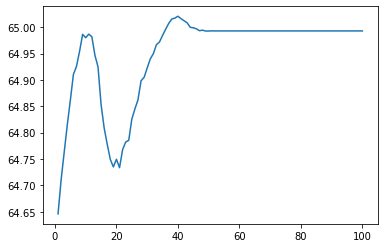

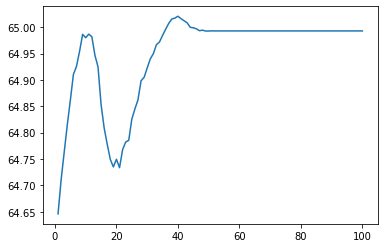

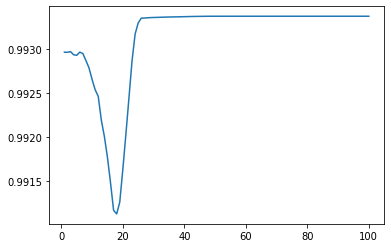

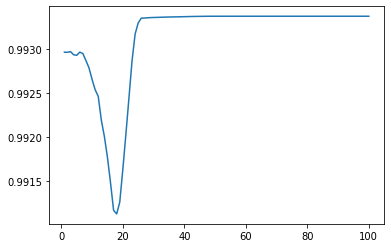

In [ ]:
#plotting the psnr and ssim between the original image and the noisy image restored using soft/ harrd thresholding
x_axis = np.linspace(1,100,100)
plt.plot(x_axis, PSNR_soft)
plt.show()
plt.plot(x_axis, PSNR_soft)
plt.show()
plt.plot(x_axis, SSIM_hard)
plt.show()
plt.plot(x_axis, SSIM_hard)
plt.show()

Thus, soft and hard thresholding follow similar trends on varying the variance. We see that maximum psnr is obtained when the variance of the filter is equal to the noise variance

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


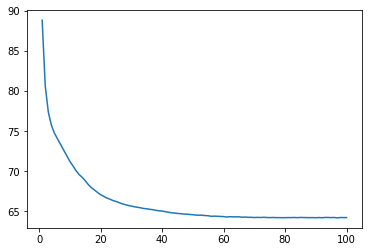

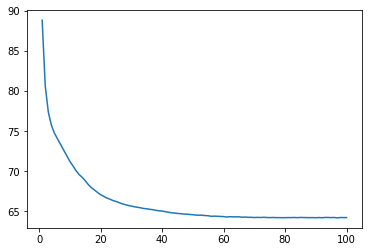

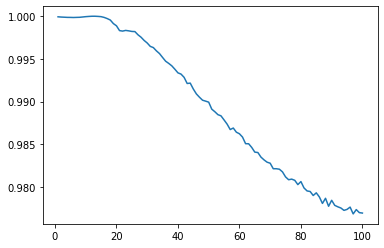

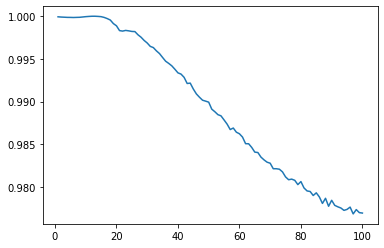

In [ ]:
#varying variance of the noise as well as the threshold
PSNR_soft = []
SSIM_soft = []
PSNR_hard = []
SSIM_hard = []

for var in range(1, 101): 
  img1 = mav.copy()
  for i in range(3):
    AWGN = np.random.normal(mean,  var, (shape[0], shape[1]))
    # img1[:,:,i] = np.clip(img1[:,:,i] + AWGN,0,255)
    img1[:,:,i] = img1[:,:,i] + AWGN
  donoho = var*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}
  img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img1_g= img1[:,:,1]
  img1_r= img1[:,:,2]
  img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
  img1_finale_hard = img1.copy()
  newimg_soft_b = waveletthresholded_soft(img1_b) # Summary of this cell: We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
  newimg_hard_b = waveletthresholded_hard(img1_b)
  newimg_soft_g = waveletthresholded_soft(img1_g)
  newimg_hard_g = waveletthresholded_hard(img1_g)
  newimg_soft_r = waveletthresholded_soft(img1_r)
  newimg_hard_r = waveletthresholded_hard(img1_r)
  img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color nad diplayed respectively for soft and hard thresholdings
  img1_finale_soft[:,:,1] = newimg_soft_g
  img1_finale_soft[:,:,2] = newimg_soft_r
  img1_finale_hard[:,:,0] = newimg_hard_b
  img1_finale_hard[:,:,1] = newimg_hard_g
  img1_finale_hard[:,:,2] = newimg_hard_r
  #Appending the PSNR and SSIM for soft and hard thresholding
  PSNR_soft.append(psnr_func(mav , img1_finale_soft))
  SSIM_soft.append(np.mean(ssim_func(mav , img1_finale_soft)))
  PSNR_hard.append(psnr_func(mav , img1_finale_hard))
  SSIM_hard.append(np.mean(ssim_func(mav , img1_finale_hard)))

x_axis = np.linspace(1,100,100)
plt.plot(x_axis, PSNR_soft)
plt.show()
plt.plot(x_axis, PSNR_soft)
plt.show()
plt.plot(x_axis, SSIM_hard)
plt.show()
plt.plot(x_axis, SSIM_hard)
plt.show()

In this case, again soft and hard thresholding follow similar trends. However, the PSNR and SSIM decrease with increasing variance, the psnr stabilizes at a value with SSIM doesn't for our range

##d
The method of Chen et al

In [ ]:
window_size = 3**2 #square windows, optimum is at 3
img2 = img1.copy()

PSNR = []
SSIM = []
coeffs = pywt.dwt2(mav_gray, 'haar') # The coefficients of the tuple of level 1 wavelet transform i.e. LL, LH, HL, HH are stored as tuple form after performing dwt2 operation for haar wavelet
cA, (cH, cV, cD) = coeffs # respective coefficents are stored in arrays in tuple form

for var in range(1, 101): 
  #defining the thresholding for the chen et al method
  chen = np.sqrt(4*math.log(window_size)*var**2)
  pad = int((np.sqrt(window_size)-1)/2)
  cH_pad = cv2.copyMakeBorder(cH,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cH, to check for boundary condition, we are zero-padding the wavelet transforms 
  cV_pad = cv2.copyMakeBorder(cV,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cV, to check for boundary condition, we are zero-padding the wavelet transforms 
  cD_pad = cv2.copyMakeBorder(cD,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cD, to check for boundary condition, we are zero-padding the wavelet transforms
  img2_b= img2[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img2_g= img2[:,:,1]
  img2_r= img2[:,:,2]
  img2_finale_chen = img2.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly 
  newimg_chen_b = waveletthresholded_chen(img2_b)
  newimg_chen_g = waveletthresholded_chen(img2_g)
  newimg_chen_r = waveletthresholded_chen(img2_r)
  img2_finale_chen[:,:,0] = newimg_chen_b
  img2_finale_chen[:,:,1] = newimg_chen_g
  img2_finale_chen[:,:,2] = newimg_chen_r
  #appending the psnr and ssim lists
  PSNR.append(psnr_func(mav , img2_finale_chen))
  SSIM.append(np.mean(ssim_func(mav , img2_finale_chen)))

print(PSNR)
print(SSIM)

[64.55987012882969, 64.55989192599085, 64.55971228873558, 64.56017479231062, 64.55350864127342, 64.55065944422589, 64.55487807680908, 64.56234578832368, 64.57632446272387, 64.57958288353154, 64.58135636038156, 64.58247749858735, 64.60245079298784, 64.613709419833, 64.62889632098496, 64.63361350312165, 64.64446359072603, 64.67076270651592, 64.67639923835412, 64.69888852648539, 64.70605680466961, 64.70826784445923, 64.73648521773859, 64.74979774123992, 64.7739931671944, 64.8247548596889, 64.84907736172227, 64.84518727990813, 64.87702509301626, 64.88479070180463, 64.90967471404636, 64.92573448527142, 64.94076828736375, 64.93656010302335, 64.96737424950803, 64.9537172410815, 64.95611015303805, 64.9688010325668, 64.96803789883658, 64.9666767214202, 64.96112015469903, 64.97151214195313, 64.96065985468218, 64.96152335841077, 64.96183581334707, 64.94664766970254, 64.94067120750634, 64.92486185306208, 64.93217217552245, 64.92800997593244, 64.93438748712128, 64.91612699478932, 64.89430672068723,

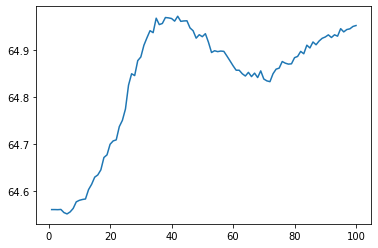

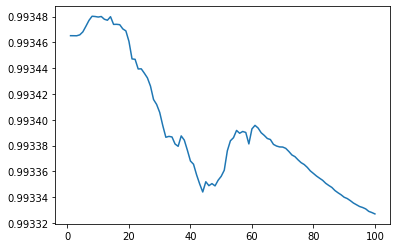

In [ ]:
x_axis = np.linspace(1,100,100)
plt.plot(x_axis, PSNR)
plt.show()
plt.plot(x_axis, SSIM)
plt.show()

In this method,PSNR is maximum and SSIM has a local minima when the variance = noise variance

##e
When the method is independently applied to RGB channels, versus when the method is applied to Ichannel of HSI transform. 

> When the method is independently applied to RGB channels, versus when the method is applied to I
channel of HSI transform.

Saving tg_casual.jpg to tg_casual (3).jpg


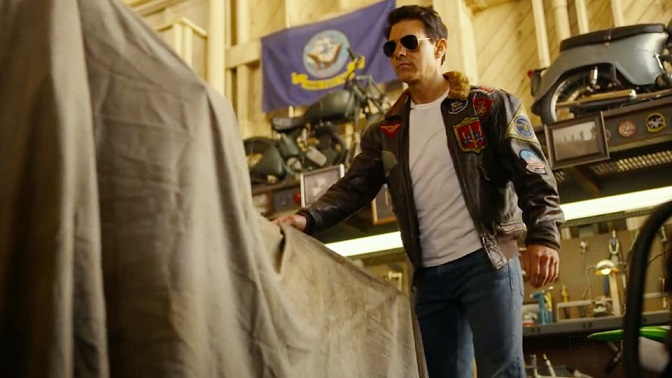

In [ ]:
files.upload()
cas = cv2.imread("tg_casual.jpg")
cv2_imshow(cas)

In [ ]:
files.upload()
gray = cv2.imread("tg_casual.jpg", 0)

Saving tg_casual.jpg to tg_casual (2).jpg


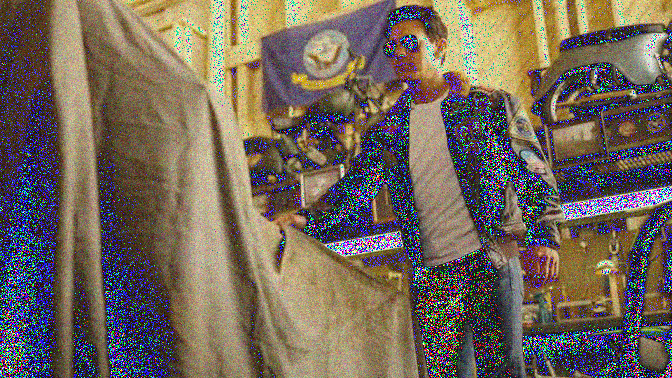

In [ ]:
shape = cas.shape
mean = 0
var1 = 20

#Adding AWGN of std dev 20 to our image
img1 = cas.copy()
for i in range(3):
  AWGN = np.random.normal(mean,  var1, (shape[0], shape[1]))
  img1[:,:,i] = img1[:,:,i] + AWGN
cas_gray = gray + AWGN
cv2_imshow(img1)

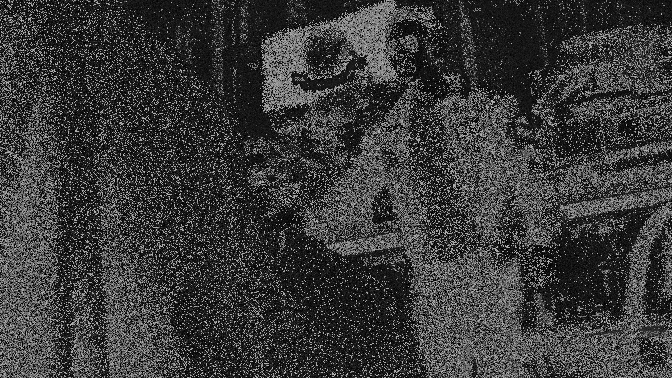

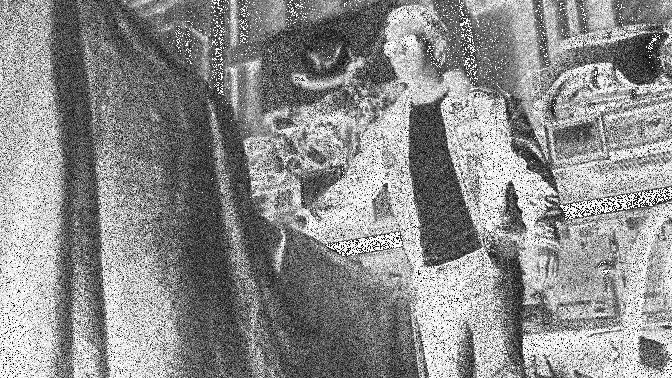

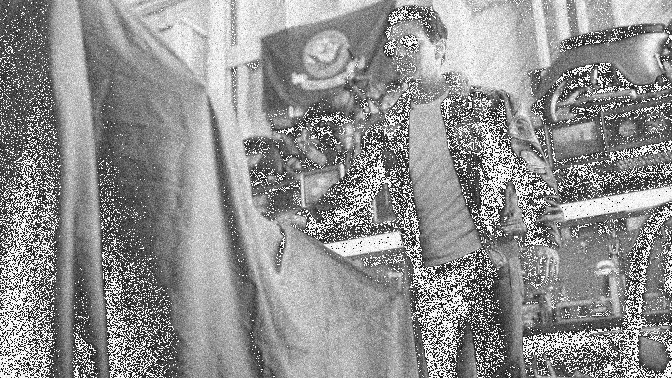

In [ ]:
#converting the image from BGR to HSI and displaying the channels seperately
img2 = cv2.cvtColor(img1, cv2.COLOR_BGR2HSV)
cv2_imshow(img2[:,:,0])
cv2_imshow(img2[:,:,1])
cv2_imshow(img2[:,:,2])

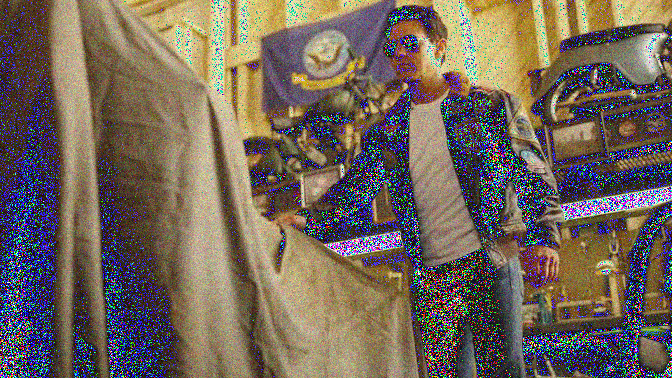

In [ ]:
#converting hsi back to bgr and displaying
img3 = cv2.cvtColor(img2, cv2.COLOR_HSV2BGR)
cv2_imshow(img3)

In [ ]:
#using the method of chen et al on the BGR channels and I channel of HSI
window_size = 3**2 #square windows, optimum is at 3
peak = 255

PSNR_bgr = []
SSIM_bgr = []
PSNR_hsi = []
SSIM_hsi = []
coeffs = pywt.dwt2(cas_gray, 'haar') # The coefficients of the tuple of level 1 wavelet transform i.e. LL, LH, HL, HH are stored as tuple form after performing dwt2 operation for haar wavelet
cA, (cH, cV, cD) = coeffs # respective coefficents are stored in arrays in tuple form

for var in range(1, 101): 
  chen = np.sqrt(4*math.log(window_size)*var**2)
  pad = int((np.sqrt(window_size)-1)/2)
  cH_pad = cv2.copyMakeBorder(cH,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cH, to check for boundary condition, we are zero-padding the wavelet transforms 
  cV_pad = cv2.copyMakeBorder(cV,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cV, to check for boundary condition, we are zero-padding the wavelet transforms 
  cD_pad = cv2.copyMakeBorder(cD,pad,pad,pad,pad,cv2.BORDER_CONSTANT, None, value = 0) #As this method is using dynamic window size to move around the whole transformed image cD, to check for boundary condition, we are zero-padding the wavelet transforms
  img2 = img1.copy()
  img3 = img1.copy()
  img2_b= img2[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img2_g= img2[:,:,1]
  img2_r= img2[:,:,2]
  img2_finale_chen = img2.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly 
  newimg_chen_b = waveletthresholded_chen(img2_b)
  newimg_chen_g = waveletthresholded_chen(img2_g)
  newimg_chen_r = waveletthresholded_chen(img2_r)
  img2_finale_chen[:,:,0] = newimg_chen_b
  img2_finale_chen[:,:,1] = newimg_chen_g
  img2_finale_chen[:,:,2] = newimg_chen_r
  #appending the lists for the bgr image
  PSNR_bgr.append(psnr_func(cas , img2_finale_chen))
  SSIM_bgr.append(np.mean(ssim_func(cas , img2_finale_chen)))
  #converting the image to hsv
  imghsv = cv2.cvtColor(img3, cv2.COLOR_BGR2HSV)
  hsv_chen = imghsv.copy()
  #applying thresholding on I
  hsv_chen[:,:,2] = waveletthresholded_chen(imghsv[:,:,2])
  #cpnverting back to bgr
  hsv2bgr = cv2.cvtColor(hsv_chen, cv2.COLOR_HSV2BGR)
  #appending the lists for hsv
  PSNR_hsi.append(psnr_func(cas , hsv2bgr))
  SSIM_hsi.append(np.mean(ssim_func(cas , hsv2bgr)))

print(PSNR_bgr)
print(PSNR_hsi)

[66.14767242515555, 66.14786333029615, 66.14936570629803, 66.17525017773066, 66.21490029648903, 66.26882756035796, 66.33377012449516, 66.41702010941866, 66.53070929846172, 66.6431045596512, 66.78727014338624, 66.9379188722437, 67.09188179744291, 67.2413800662695, 67.37681882082668, 67.48721206617161, 67.58659735606307, 67.65959780058449, 67.72476951910674, 67.77323060358461, 67.8099849856983, 67.83076811563433, 67.84472089337311, 67.8566610509198, 67.85979942802553, 67.85546208933376, 67.8672162564829, 67.8607380241075, 67.85235810219605, 67.84322797091362, 67.83333864156923, 67.82591661661898, 67.82470584546917, 67.80572570525108, 67.7988030693141, 67.79037390625568, 67.78157831142066, 67.78501436421904, 67.76791653147234, 67.76142178969637, 67.75634333442385, 67.75300780088516, 67.74262501960088, 67.7479115304938, 67.74507230428964, 67.73117381782308, 67.7263187293828, 67.72157119797687, 67.71632412796819, 67.73033584168964, 67.71927975857386, 67.71575931248046, 67.70751280112133, 67

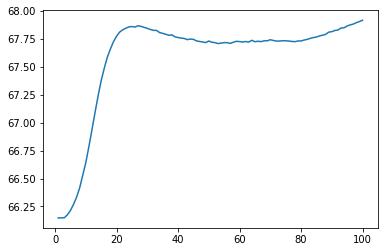

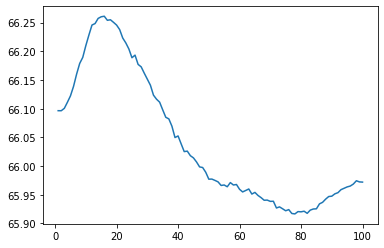

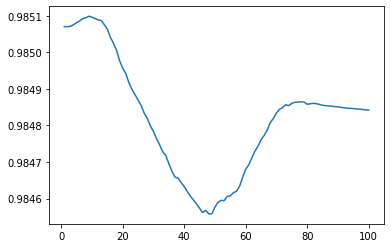

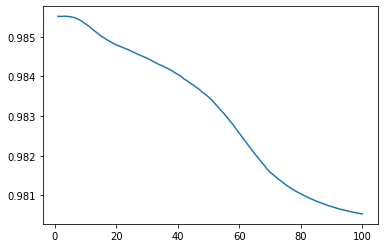

In [ ]:
x_axis = np.linspace(1,100,100)
plt.plot(x_axis, PSNR_bgr)
plt.show()
plt.plot(x_axis, PSNR_hsi)
plt.show()
plt.plot(x_axis, SSIM_bgr)
plt.show()
plt.plot(x_axis, SSIM_hsi)
plt.show()

Thus, we see that applying thresholding to the R, G, B channels of the BGR image seperately gives much better results than applying thresholding to the I channel of the HSI image. In case of the BGR method, we get maximum ssim and psnr when thresholding variance= noise variance

Tried defining BGR to HSI and HSI to BGR functions

In [ ]:
# def bgr_to_hsi(img): #Defined a fuction to convert values from RGB to HSI
#   img_b=(img[:,:,0])/255 #Normalize the value in the range (0,1) by firstly converting into float values then dividing and storing each color component seperately in b,g,r subscribts
#   img_g=(img[:,:,1])/255
#   img_r=(img[:,:,2])/255
#   I = 255*(img_b+img_g+img_r)/3 # Intensity is basically the avaerage of all the three olor elemenst pixelwise
#   if I == '0': #Theoritically if Intensity is zero then Saturation is also zero
#     S = 0
#   else:
#     S = (1-((3*np.minimum(img_b,img_g,img_r))/I)) #Else we subtract 1 from the 3 multiplication of minimum value among the color component with Intensity divided 
#   H = img[:,:,0].copy()#not sure
#   img_hsi = img.copy()
# #In order to find Hue, we have to move pixel wise to calculate diffrence between red, green and red, blue pixels and then perfoeming the mathematial operations
#   for i in range(img_b.shape[0]): 
#     for j in range(img_b.shape[1]):
#       # H[i][j]= math.acos(0.5*((img_r[i][j]-img_g[i][j])+(img_r[i][j]-img_b[i][j]))/(math.sqrt((img_r[i][j]-img_g[i][j])**2+((img_r[i][j]-img_g[i][j])*(img_r[i][j]-img_b[i][j])))))
#       H[i][j] = (0.5 * ((img_r[i][j] - img_g[i][j]) + (img_r[i][j] - img_b[i][j])) / math.sqrt((img_r[i][j] - img_g[i][j])**2 + ((img_r[i][j] - img_b[i][j]) * (img_g[i][j] - img_b[i][j]))))
#       H[i][j] = math.acos(H[i][j])
#       if (img_b[i,j] >= img_g[i,j]): #if Blue pixel values are larger with respect to corresponding green pixel then we reflect the hue value about 360 degrees
#         H[i,j] = ((360.00*math.pi)/180.00)-H[i,j]
#   img_hsi[:,:,0] = H #Storing all the calculated values in the third dimenstion of final image according to the convention of H,S and I
#   img_hsi[:,:,1] = S
#   img_hsi[:,:,2] = I
#   return img_hsi

#Reference used: Slides and https://www.had2know.org/technology/hsi-rgb-color-converter-equations.html#:~:text=Equations%20to%20Convert%20RGB%20Values%20to%20HSI%20Values&text=H%20%3D%20360%20%2D%20cos%2D1,cosine%20output%20is%20in%20degrees.

In [ ]:
# def hsi_to_bgr(img_hsi):
#     S = img_hsi[:,:,1]
#     I = img_hsi[:,:,2]
#     for i in range(img_hsi.shape[0]): 
#       for j in range(img_hsi.shape[1]):
#         H = math.degrees(img_hsi[i,j,0])

#         if 0 <= H[i,j] <= 120 :
#             B[i,j] = I[i,j]*(1-S[i,j])
#             R[i,j] = I[i,j]*(1+(S[i,j]*math.cos(math.radians(H[i,j]))/math.cos(math.radians(60)-math.radians(H[i,j]))))
#             G[i,j] = I[i,j]*3-(R+B)
#         elif 120 < H[i,j] <= 240:
#             H[i,j] -= 120
#             R[i,j] = I[i,j]*(1-S[i,j])
#             G[i,j] = I[i,j]*(1 +(S[i,j]*math.cos(math.radians(H[i,j]))/math.cos(math.radians(60)-math.radians(H[i,j]))))
#             B[i,j] = 3*I[i,j]-(R[i,j]+G[i,j])
#         elif 240 < H[i,j] <= 360:
#             H[i,j] -= 240
#             G[i,j] = I[i,j]*(1-S[i,j])
#             B[i,j] = I[i,j]*(1+(S[i,j]*math.cos(math.radians(H[i,j]))/math.cos(math.radians(60)-math.radians(H[i,j]))))
#             R[i,j] = I[i,j]*3-(G[i,j]+B[i,j])

#     img_bgr[:,:,0] = B #Storing all the calculated values in the third dimenstion of final image according to the convention of H,S and I
#     img_bgr[:,:,1] = G
#     img_bgr[:,:,2] = R
#     return img_bgr

#Reference: https://www.had2know.org/technology/hsi-rgb-color-converter-equations.html#:~:text=Equations%20to%20Convert%20HSI%20Values%20to%20RGB%20Values&text=B%20%3D%20I%20%2B%20IS*%5B1,cos(180%2DH)%5D.&text=B%20%3D%20I%20%2B%202IS.&text=B%20%3D%20I%20%2B%20IS*cos,cos(300%2DH).&text=MAKE%20IT!

#Q4
 Compare a few of the methods from part 3 on real noisy images, where noise variance is not known, byassuming various values of the noise variance as trial and error

In this question, we have three real noisy images. We try to restore them using soft and hard thresholding and gaussian low pass filtering. The std dev for the thresholding is varied in steps of 10 while for the glp, the var is varied in steps of 0.2

Saving img22.jpg to img22.jpg


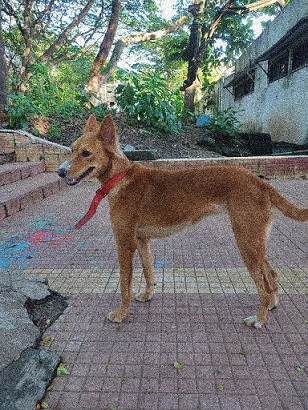

In [ ]:
#uploading and displaying images
files.upload()
img = cv2.imread("img22.jpg")
cv2_imshow(img)

0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in true_divide
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


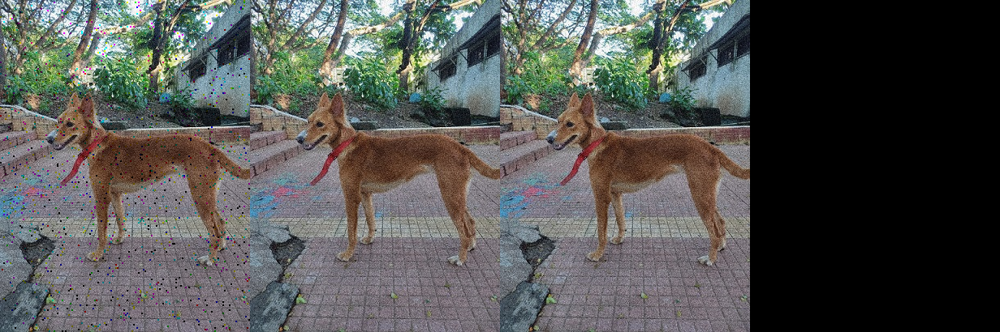

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


10


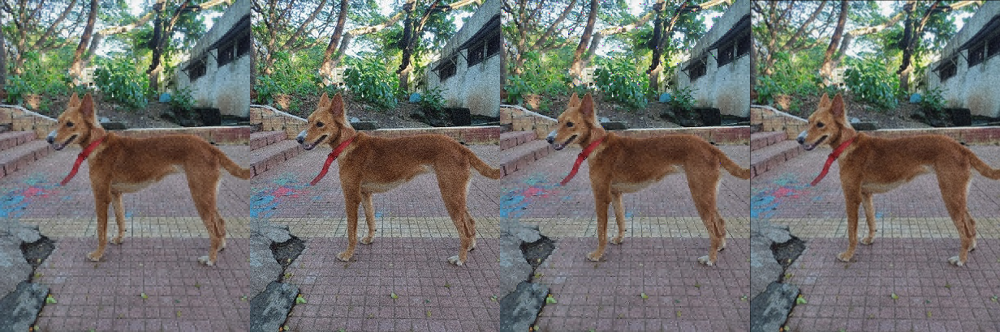

20


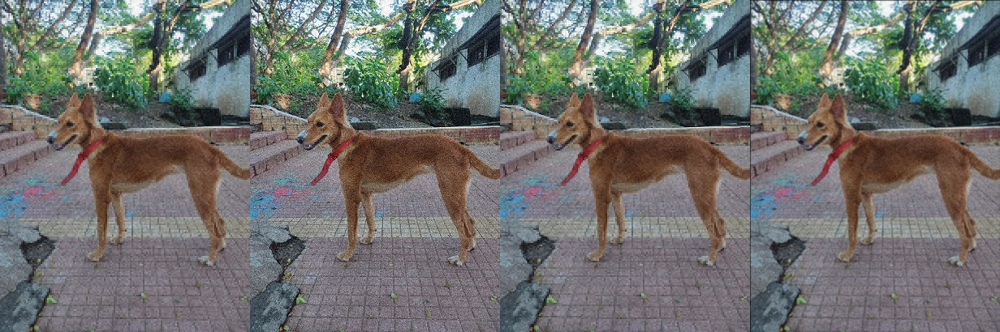

30


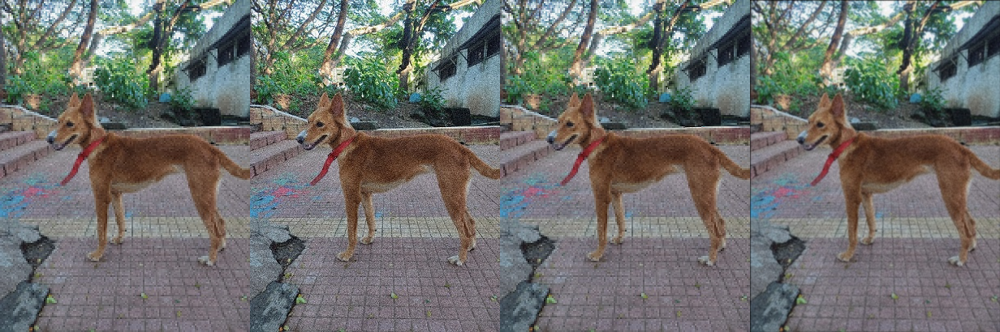

40


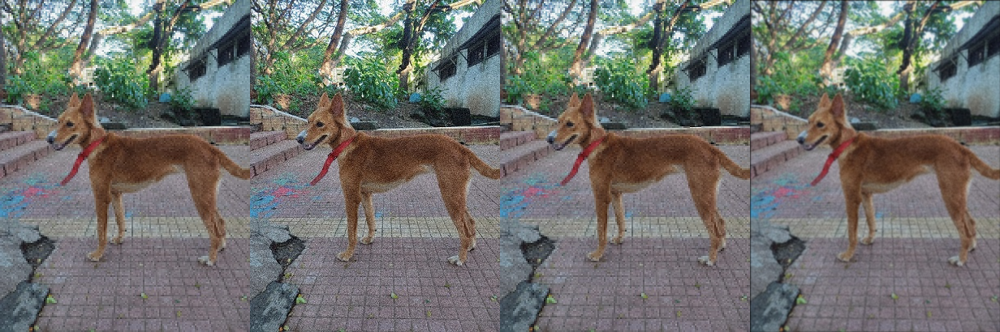

50


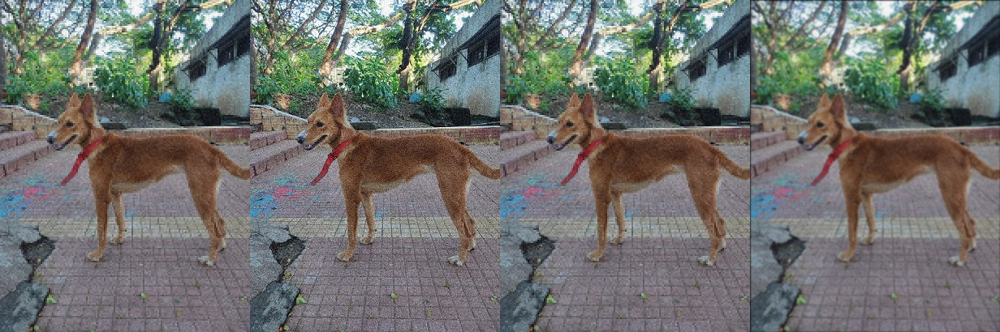

60


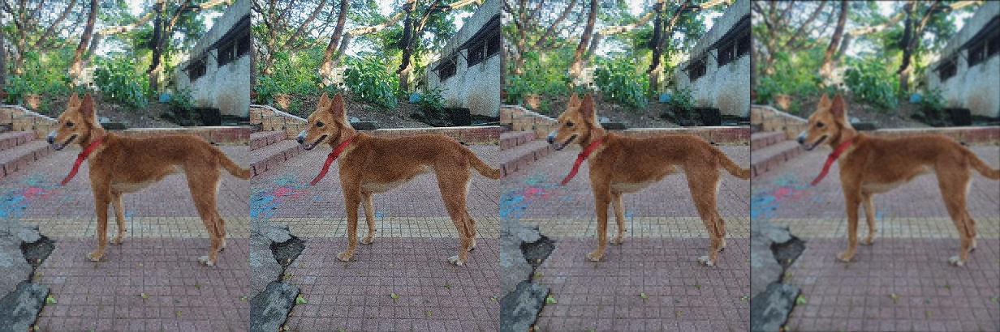

70


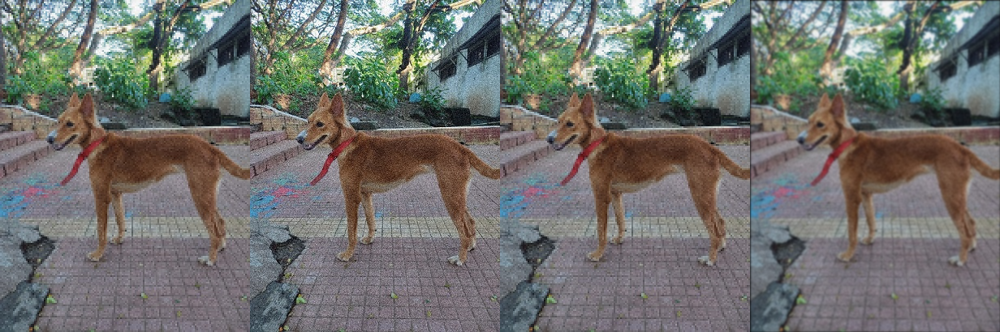

80


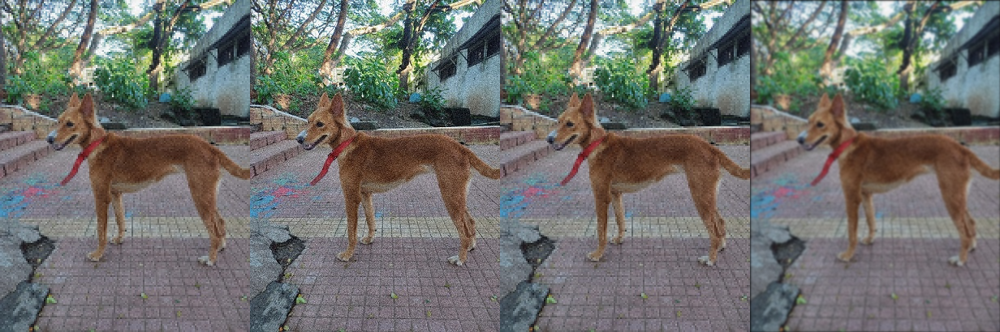

90


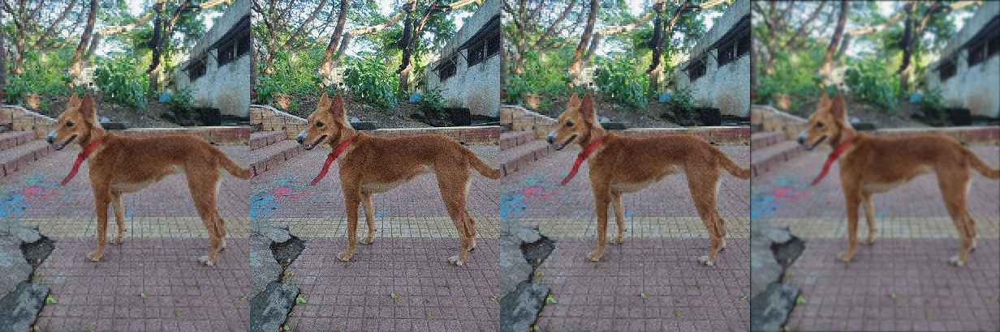

In [ ]:
from matplotlib.patches import ConnectionPatch
h,w =  img.shape[:2] # Stored the Height and Width of the image in variables h and w
window_size = h*w # Created a variable window_size to store h*w

#looping over various variances(std devs)
for i in range(10):
  #std dev in steps of 10
  var = 10*i
  img1= img.copy()
  donoho = var*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}
  img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img1_g= img1[:,:,1]
  img1_r= img1[:,:,2]
  img1_finale_hard = img1.copy()
  img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
  newimg_soft_b = waveletthresholded_soft(img1_b) # Summary of this cell: We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
  newimg_hard_b = waveletthresholded_hard(img1_b)  
  newimg_soft_g = waveletthresholded_soft(img1_g)
  newimg_hard_g = waveletthresholded_hard(img1_g)
  newimg_soft_r = waveletthresholded_soft(img1_r)
  newimg_hard_r = waveletthresholded_hard(img1_r)
  img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color nad diplayed respectively for soft and hard thresholdings
  img1_finale_soft[:,:,1] = newimg_soft_g
  img1_finale_soft[:,:,2] = newimg_soft_r
  img1_finale_hard[:,:,0] = newimg_hard_b
  img1_finale_hard[:,:,1] = newimg_hard_g
  img1_finale_hard[:,:,2] = newimg_hard_r
  img2  = img.copy()
  #blurring the image with var in steps of 0.2
  blur_img = glp_filter(img2,i/5)
  print(var)
  concat = np.concatenate((img1_finale_soft, img1, img1_finale_hard,blur_img),axis=1)
  cv2_imshow(concat)

Above we have the soft thresholded image, original noisy image, hard thresholded image and glp filtered image. Here glp filtering with a variance of 0.4 seems to be giving the best result

Applying the same steps to the other two images below

Saving image1.jpg to image1.jpg


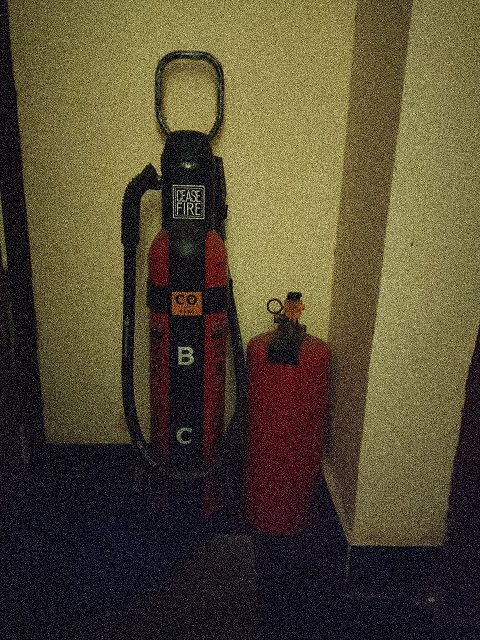

In [ ]:
files.upload()
img = cv2.imread("image1.jpg")
cv2_imshow(img)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in true_divide
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


0


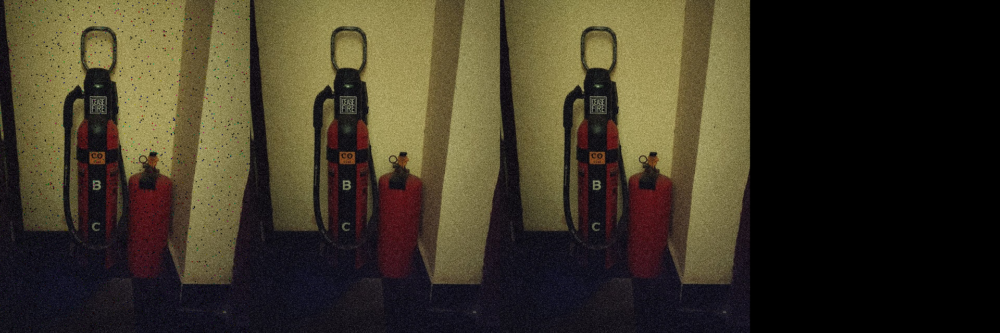

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


10


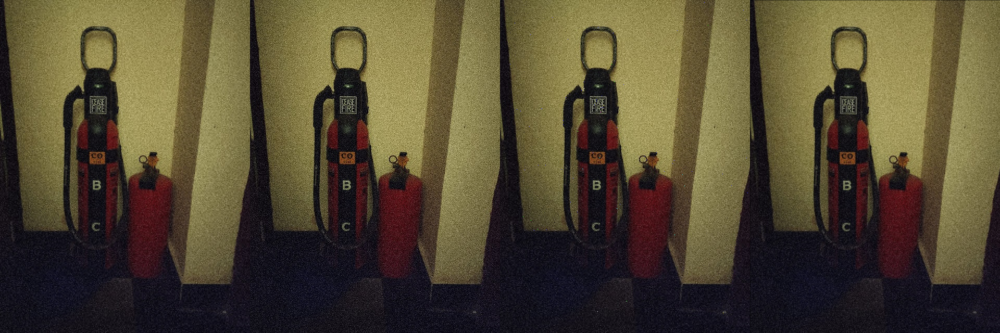

20


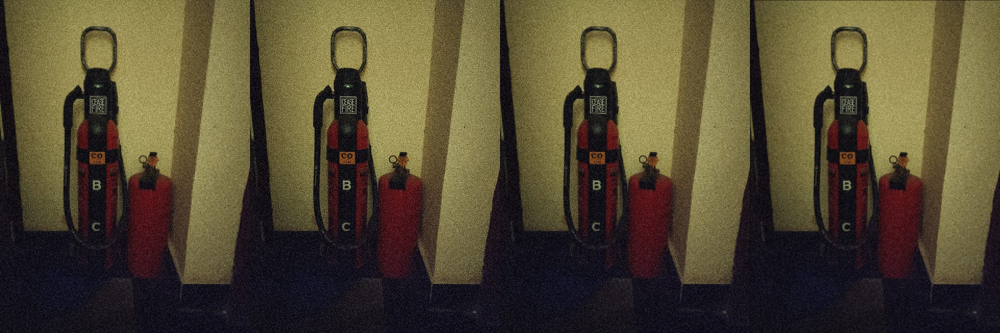

30


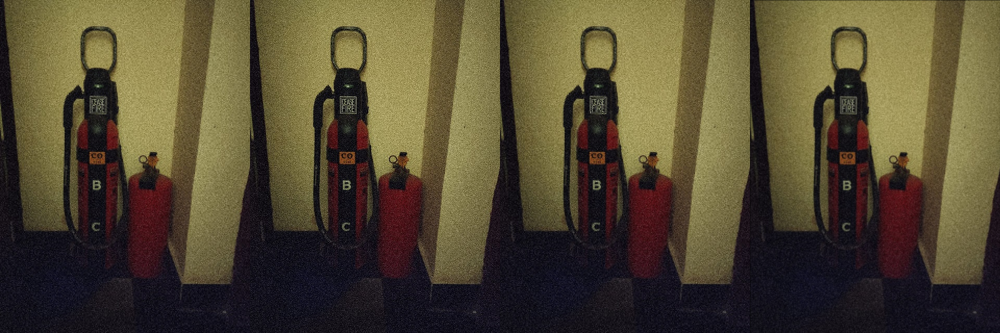

40


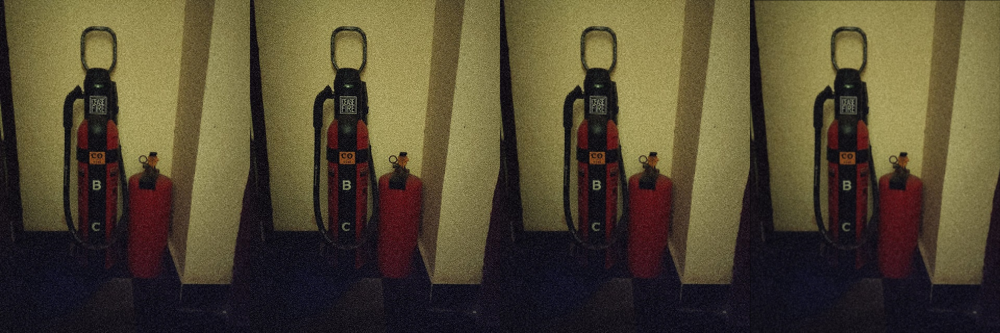

50


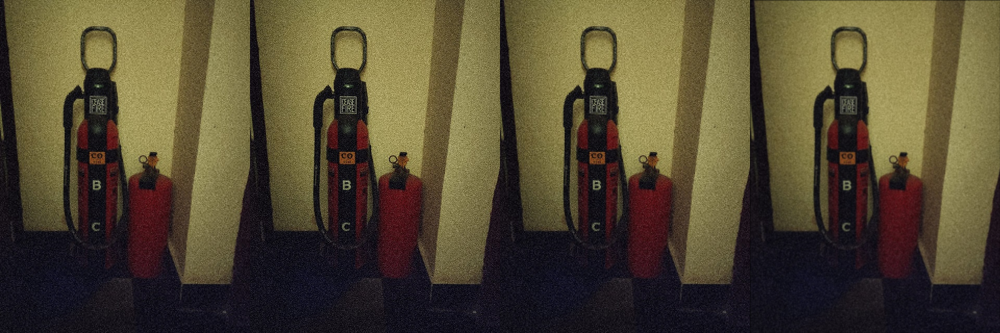

60


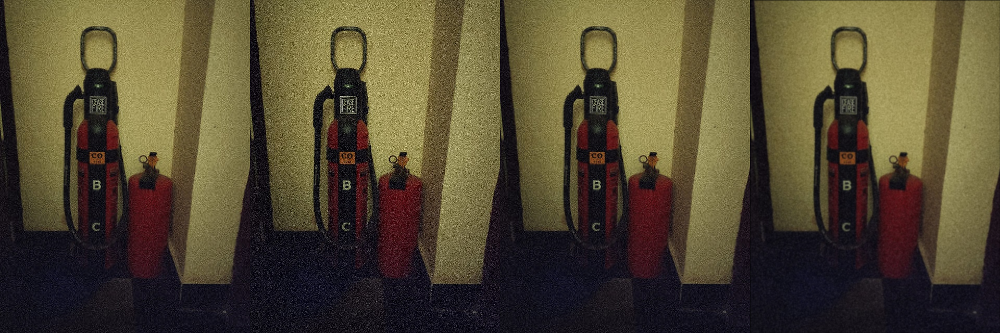

70


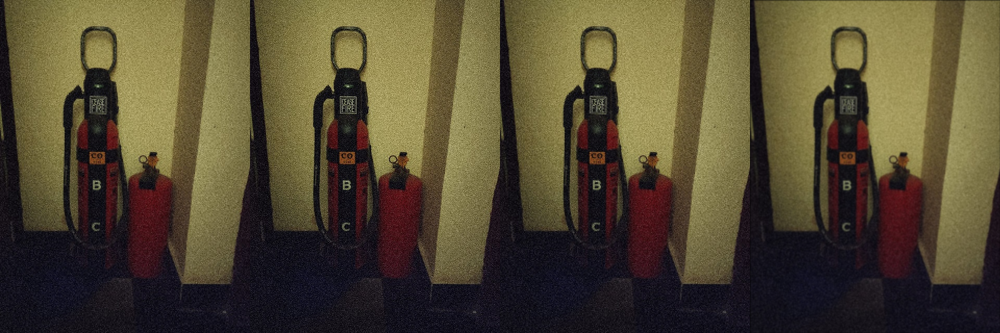

80


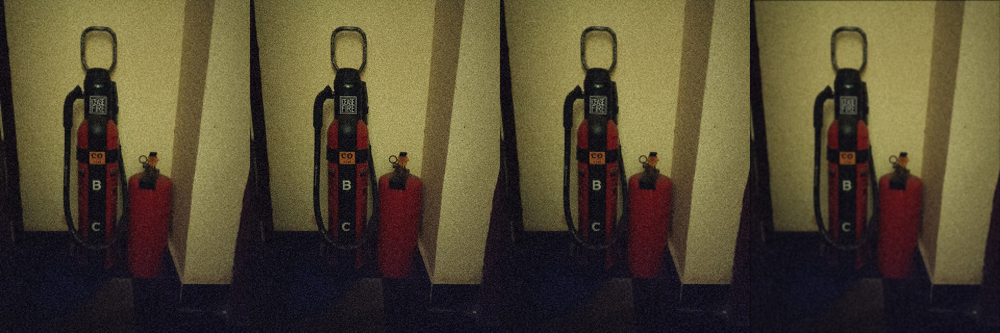

90


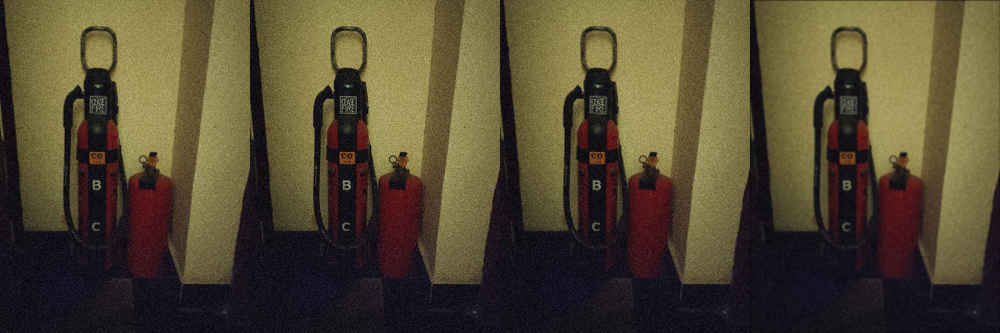

In [ ]:
h,w =  img.shape[:2] # Stored the Height and Width of the image in variables h and w
window_size = h*w # Created a variable window_size to store h*w

for i in range(10):
  var = 10*i
  img1= img.copy()
  donoho = var*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}
  img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img1_g= img1[:,:,1]
  img1_r= img1[:,:,2]
  img1_finale_hard = img1.copy()
  img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
  newimg_soft_b = waveletthresholded_soft(img1_b) # Summary of this cell: We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
  newimg_hard_b = waveletthresholded_hard(img1_b)  
  newimg_soft_g = waveletthresholded_soft(img1_g)
  newimg_hard_g = waveletthresholded_hard(img1_g)
  newimg_soft_r = waveletthresholded_soft(img1_r)
  newimg_hard_r = waveletthresholded_hard(img1_r)
  img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color nad diplayed respectively for soft and hard thresholdings
  img1_finale_soft[:,:,1] = newimg_soft_g
  img1_finale_soft[:,:,2] = newimg_soft_r
  img1_finale_hard[:,:,0] = newimg_hard_b
  img1_finale_hard[:,:,1] = newimg_hard_g
  img1_finale_hard[:,:,2] = newimg_hard_r
  img2  = img.copy()
  #blurring the image with var in steps of 0.2
  blur_img = glp_filter(img2,i/5)
  print(var)
  concat = np.concatenate((img1_finale_soft, img1, img1_finale_hard, blur_img),axis=1)
  cv2_imshow(concat)

Above we have the soft thresholded image, original noisy image, hard thresholded image and glp filtered image. Here soft thresholding with a std dev of 80 seems to be giving decent results

Saving img33.jpg to img33 (2).jpg


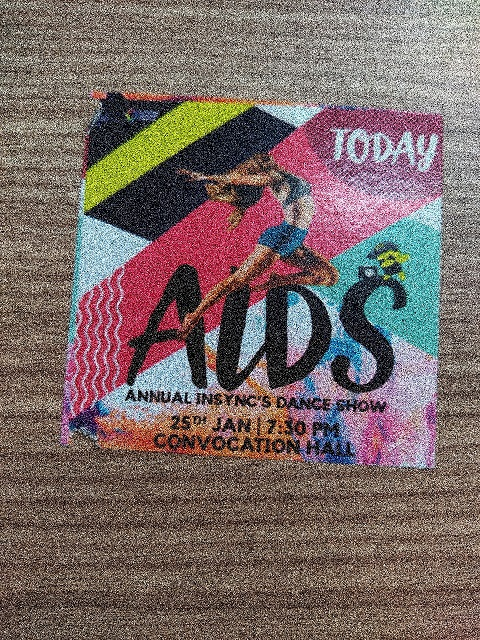

In [ ]:
files.upload()
img = cv2.imread("img33.jpg")
cv2_imshow(img)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in true_divide
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


0


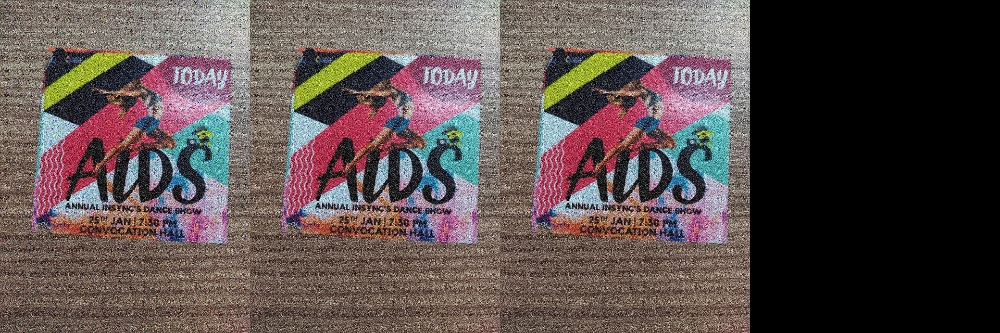

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


In [ ]:
h,w =  img.shape[:2] # Stored the Height and Width of the image in variables h and w
window_size = h*w # Created a variable window_size to store h*w

for i in range(1,10):
  var = 10*i
  img1= img.copy()
  donoho = var*np.sqrt(2*math.log(window_size)) #Created a Threshold value using the donoho expresion of sigma*\root{2*log(window size)}
  img1_b= img1[:,:,0] #Spliting the third dimension of image to correspondings Blue, Green and Red
  img1_g= img1[:,:,1]
  img1_r= img1[:,:,2]
  img1_finale_hard = img1.copy()
  img1_finale_soft = img1.copy() # Making a finale copy on hand to be used afterwards for both soft and hard respectivly
  newimg_soft_b = waveletthresholded_soft(img1_b) # Summary of this cell: We passed all the three dimesions "Blue", "Green", and "Red" to the cascading functions seperatly and displayed column wise
  newimg_hard_b = waveletthresholded_hard(img1_b)  
  newimg_soft_g = waveletthresholded_soft(img1_g)
  newimg_hard_g = waveletthresholded_hard(img1_g)
  newimg_soft_r = waveletthresholded_soft(img1_r)
  newimg_hard_r = waveletthresholded_hard(img1_r)
  img1_finale_soft[:,:,0] = newimg_soft_b #Merged all the three dimensions of color nad diplayed respectively for soft and hard thresholdings
  img1_finale_soft[:,:,1] = newimg_soft_g
  img1_finale_soft[:,:,2] = newimg_soft_r
  img1_finale_hard[:,:,0] = newimg_hard_b
  img1_finale_hard[:,:,1] = newimg_hard_g
  img1_finale_hard[:,:,2] = newimg_hard_r
  img2  = img.copy()
  #blurring the image with var in steps of 0.2
  blur_img = glp_filter(img2,i/5)
  print(var)
  concat = np.concatenate((img1_finale_soft, img1, img1_finale_hard,blur_img),axis=1)
  cv2_imshow(concat)

Above we have the soft thresholded image, original noisy image, hard thresholded image and glp filtered image.
Due to getting disconnected from the runtime, this cell which we were able to execute earlier, wasn't executing before submitting.
 However, here glp filtering with a variance of 0.6 seems to be giving the best result

#References used

In [ ]:
#https://www.ni.com/en-in/innovations/white-papers/11/peak-signal-to-noise-ratio-as-an-image-quality-metric.html#:~:text=Back%20to%20top-,Introduction,the%20quality%20of%20its%20representation.
#https://medium.com/srm-mic/all-about-structural-similarity-index-ssim-theory-code-in-pytorch-6551b455541e
#https://pywavelets.readthedocs.io/en/latest/ref/thresholding-functions.html https://pywavelets.readthedocs.io/en/0.2.0/ref/2d-dwt-and-idwt.html
#https://pywavelets.readthedocs.io/en/0.2.0/regression/wp2d.html
#https://pywavelets.readthedocs.io/en/0.2.0/ref/thresholding-functions.html#module-pywt.thresholding
#https://www.had2know.org/technology/hsi-rgb-color-converter-equations.html#:~:text=Equations%20to%20Convert%20RGB%20Values%20to%20HSI%20Values&text=H%20%3D%20360%20%2D%20cos%2D1,cosine%20output%20is%20in%20degrees.
#https://www.had2know.org/technology/hsi-rgb-color-converter-equations.html#:~:text=Equations%20to%20Convert%20HSI%20Values%20to%20RGB%20Values&text=B%20%3D%20I%20%2B%20IS*%5B1,cos(180%2DH)%5D.&text=B%20%3D%20I%20%2B%202IS.&text=B%20%3D%20I%20%2B%20IS*cos,cos(300%2DH).&text=MAKE%20IT!